In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import cv2
import csv
import time
import tensorflow as tf
import keras
import glob
from PIL import Image
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Activation,Concatenate
from tensorflow.keras.layers import BatchNormalization, LeakyReLU, Flatten, Dense, Dropout, UpSampling2D
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.figure import Figure
from mpl_toolkits.axes_grid1 import ImageGrid
from pprint import pprint
%matplotlib inline
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from tensorflow.keras.callbacks import EarlyStopping
import logging
logging.getLogger('tensorflow').disabled = True
import warnings
warnings.filterwarnings('ignore', category=UserWarning)
import random

# Preparation and presentation of datasets

### Acquire and Preprocess Dataset

In [2]:
BATCH_SIZE = 16

train_dir = '../dataset/train/'
valid_dir = '../dataset/validation/'

train_files = glob.glob(train_dir + '*_normal_*.png')
valid_files = glob.glob(valid_dir + '*_normal_*.png')

def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images


def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image


def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images


train_dataset = tf.data.Dataset.from_tensor_slices(train_files)
valid_dataset = tf.data.Dataset.from_tensor_slices(valid_files)

train_dataset = train_dataset.map(load_and_preprocess_image)
valid_dataset = valid_dataset.map(load_and_preprocess_image)

train_dataset = train_dataset.map(normalise)
valid_dataset = valid_dataset.map(normalise)

print("Training dataset size:", len(train_files))
print("Validation dataset size:", len(valid_files))

img = train_dataset.take(1)
train_dataset_width = int(img.element_spec.shape[0])
train_dataset_height = int(img.element_spec.shape[1])

train_dataset = train_dataset.shuffle(len(train_files)).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
valid_dataset = valid_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

print("Total number of batches in training dataset:", len(list(train_dataset)))
print("Total number of batches in validation dataset:", len(list(valid_dataset)))

print("train dataset: ", tf.data.DatasetSpec.from_value(train_dataset))
print("valid dataset: ", tf.data.DatasetSpec.from_value(valid_dataset))

train_dataset = train_dataset.prefetch(100).cache()

Training dataset size: 1296
Validation dataset size: 162
Total number of batches in training dataset: 81
Total number of batches in validation dataset: 11
train dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))
valid dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


### Show some images on the train dataset

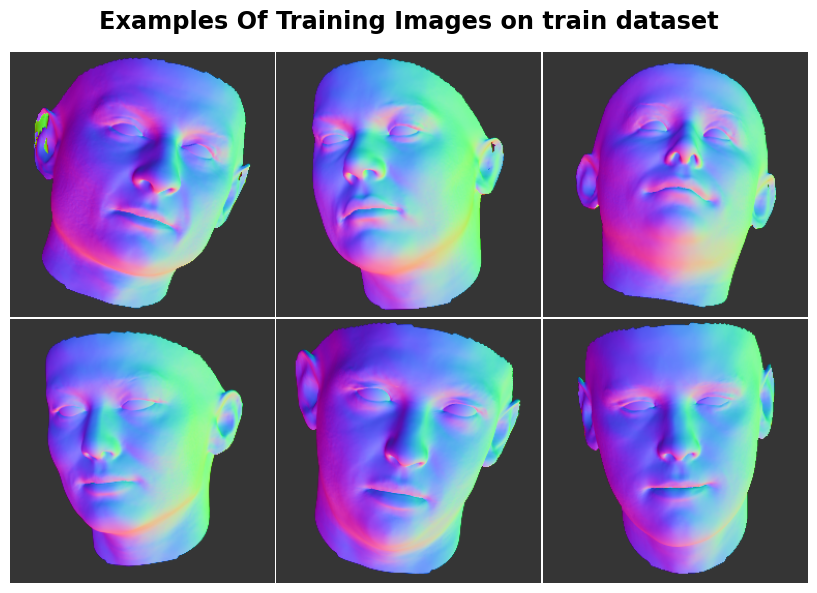

In [3]:
for images in train_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Training Images on train dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Show some images on the test dataset

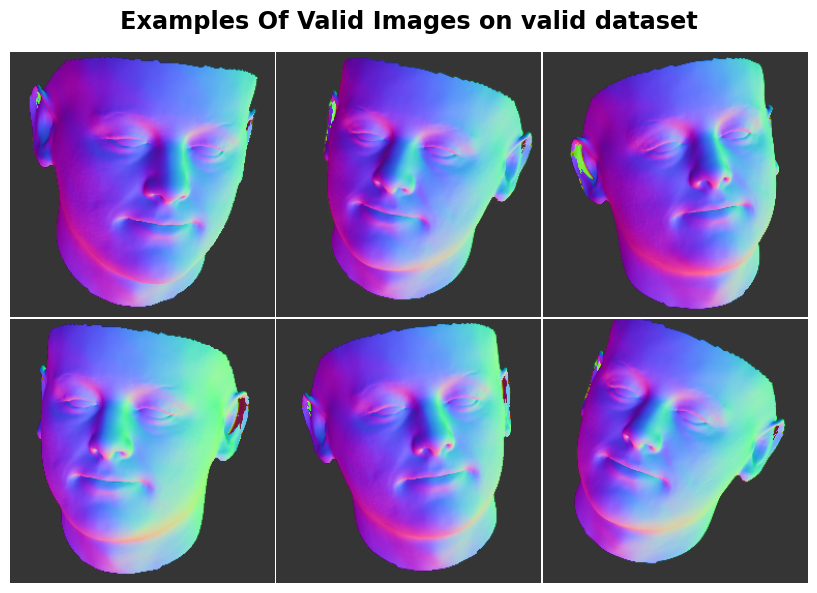

In [4]:
for images in valid_dataset.take(1):
    for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), images):
        ax.imshow((img+1)/2)
        ax.axis('off')
plt.suptitle('Examples Of Valid Images on valid dataset', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

# Mask Code Set

### Generate Irregular Mask (batch size)

In [5]:
def mask_irregular(batch_size, mask_width, mask_height):
    
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size,mask_width,mask_height,1))
    
    for _ in range(np.random.randint(1, 20)):
        
        x1, x2 = np.random.randint(1, mask_width, batch_size), np.random.randint(1, mask_width, batch_size)
        y1, y2 = np.random.randint(1, mask_height, batch_size), np.random.randint(1, mask_height, batch_size)
        thickness = np.random.randint(1, size, batch_size)
        
        for i in range(batch_size):
            cv2.line(mask[i],(x1[i], y1[i]),(x2[i],y2[i]),(1,1,1), thickness[i])

    return np.float32(((1 - mask)*2) - 1) # [-1, 1]

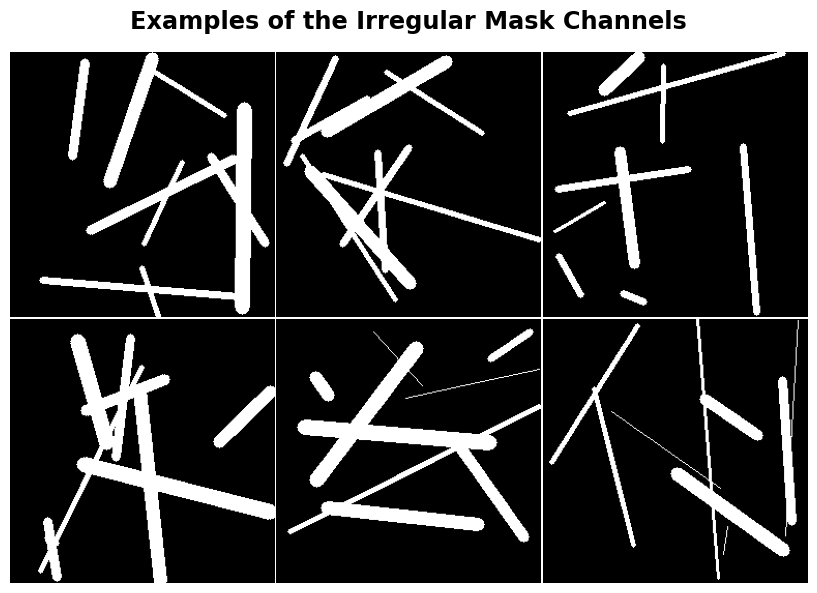

In [6]:
irregular_mask_examples = mask_irregular(6, train_dataset_width, train_dataset_height)

for ax, img in zip(ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3)), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the masked imgs (batch size)

In [7]:
def masked_imgs(raw_imgs, mask_channels):
    
    raw_imgs = (raw_imgs + 1.0) / 2.0 # [0, 1]
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    
    # masked_images = np.multiply(raw_imgs, mask_channels)
    masked_images = tf.multiply(raw_imgs, mask_channels)  # 使用 tf.multiply 替代 np.multiply
    
    masked_images = (masked_images * 2.0) - 1.0 # [-1, 1]
    
#     masked_images[:][masked_images[:] == 0] = 1. # Set the white mask
    
    return masked_images

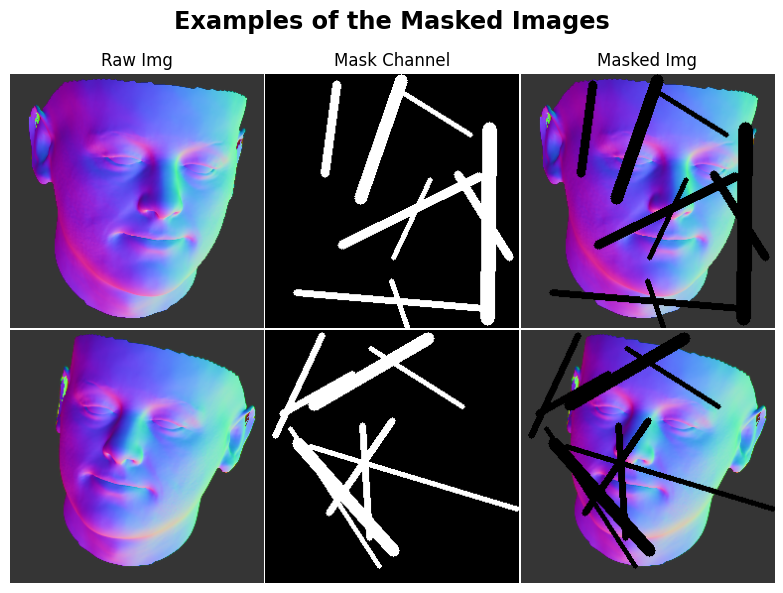

In [8]:
for images_batch in valid_dataset.take(1):
    raw_images_examples = images_batch[:2]

irregular_mask_examples = irregular_mask_examples[:2]
masked_images_examples = masked_imgs(raw_images_examples, irregular_mask_examples)

grid = ImageGrid(plt.figure(figsize=(9, 6)), 111, nrows_ncols=(2, 3))

for i in range(2):
    ax = grid[i*3]
    ax.imshow((raw_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Raw Img')
    
    ax = grid[i*3+1]
    ax.imshow((irregular_mask_examples[i]+1)/2, cmap='binary')
    ax.axis('off')
    if i == 0:
        ax.set_title('Mask Channel')
    
    ax = grid[i*3+2]
    ax.imshow((masked_images_examples[i]+1)/2)
    ax.axis('off')
    if i == 0:
        ax.set_title('Masked Img')
    
plt.suptitle('Examples of the Masked Images', fontsize='xx-large',fontweight='heavy')
plt.tight_layout()
plt.show()

### Generate the pred only masked region imgs (batch size)

In [9]:
def only_masked_region_pred_imgs(mask_channels, masked_imgs, pred_imgs):
    
    mask_channels = (mask_channels + 1.0) / 2.0 # [0, 1]
    masked_imgs = (masked_imgs + 1.0) / 2.0 # [0, 1]
    pred_imgs = (pred_imgs + 1.0) / 2.0 # [0, 1]
    
    masked_region_pred_imgs = masked_imgs + pred_imgs * (1.0 - mask_channels)
    
    masked_region_pred_imgs = (masked_region_pred_imgs * 2.0) - 1.0 # [-1, 1]
    
    return masked_region_pred_imgs

# Painting Function

In [10]:
def generator_plot_images(gen_model, text, dataset, num=3, save_path='./saved_images', epoch=0, save_images=False):
    os.makedirs(save_path, exist_ok=True)
    
    for images_batch in dataset.take(1):
        raw_images = images_batch
        mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
        masked_images = masked_imgs(raw_images, mask_channels)
        pred_images = gen_model([masked_images, mask_channels], training=False)
        pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

        masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)
    
    grid = ImageGrid(plt.figure(figsize=(12, num*3)), 111, nrows_ncols=(num, 4))
    
    for i in range(num):
        
        ax = grid[i*4]
        ax.imshow((raw_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Raw {} Img'.format(text))

        ax = grid[i*4+1]
        ax.imshow((masked_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Masked {} Img'.format(text))
            
        ax = grid[i*4+2]
        ax.imshow((pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred {} Img'.format(text))
        
        ax = grid[i*4+3]
        ax.imshow((masked_region_pred_images[i]+1)/2)
        ax.axis('off')
        if i == 0:
            ax.set_title('Pred Only Masked Reg. {} Img'.format(text))
        
    plt.tight_layout()
    if save_images:
        image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
        plt.savefig(image_save_path)   
    plt.show()

In [11]:
def plot_loss_metric(train_loss, train_metric, valid_loss, valid_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the valid set
    ax_valid_loss = ax2
    ax_valid_metric = ax2.twinx()
    ax_valid_loss.plot(x_values, valid_loss, color='tab:green')
    ax_valid_metric.plot(x_values, valid_metric, color='tab:purple')

    ax_valid_loss.set_xlabel('Epochs')
    ax_valid_loss.set_ylabel('Loss', color='tab:green')
    ax_valid_metric.set_ylabel(metric, color='tab:purple')

    ax_valid_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_valid_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('Valid - ' + title)

    plt.tight_layout()
    plt.show()

# Model Definition Code Set

### Define the loss

In [12]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
# Cosine Similarity
cosine_loss = tf.keras.losses.CosineSimilarity(axis=3)

### Generator (encoder-decoder network)

In [13]:
class UnitNormalize(tf.keras.layers.Layer):
    def __init__(self):
        super(UnitNormalize, self).__init__()

    def call(self, inputs):
        return tf.math.l2_normalize(inputs, axis=2, epsilon=1e-6)

In [14]:
def generator_model():
    
    masked_image = tf.keras.layers.Input(shape=((256, 256, 3)))
    mask = tf.keras.layers.Input(shape=((256, 256, 1)))
    maskedImage_mask = tf.keras.layers.concatenate([masked_image, mask])
    
    # Encoder with skip connections
    skips = []
    
    # Encoder - Input a masked image and mask
    
    # (256, 256, 4) -> (128, 128, 64) 
    x = Conv2D(64, kernel_size=4, strides=2, padding="same")(maskedImage_mask)
    x = LeakyReLU(alpha=0.2)(x)
    skips.append(x)
    
    # (128, 128, 64) -> (64, 64, 128) 
    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (64, 64, 128) -> (32, 32, 256) 
    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (32, 32, 256) -> (16, 16, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (16, 16, 512) -> (8, 8, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (8, 8, 512) -> (4, 4, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # (4, 4, 512) -> (2, 2, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)

    # (2, 2, 512) -> (1, 1, 512) 
    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = BatchNormalization()(x)
    skips.append(x)
    
    # Decoder
    # Decoder with skip connections
    # Assuming x is the output of the last layer of the encoder
    for skip_layer in reversed(skips[:-1]):  # Not using the last skip connection
        x = Conv2DTranspose(x.shape[-1] // 2, kernel_size=4, strides=2, padding="same")(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = BatchNormalization()(x)
        x = Concatenate()([x, skip_layer])  # skip connection
    
    # Final layer
    # (128, 128, 16) -> (256, 256, 3)
    x = Conv2DTranspose(3, kernel_size=4,strides=2,padding="same")(x)
    
    x = Activation('tanh')(x) # [-1, 1]
    output = UnitNormalize()(x)
    
    model = tf.keras.Model(inputs=[masked_image, mask], outputs=output)

    return model

In [15]:
def generator_loss(fake_output, target_images, generated_images, 
                   lambda_reconstruction = 100, lambda_adversarial=1):
    
    reconstruction_loss = 1 + cosine_loss(target_images, generated_images)
    
    adversarial_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
    
    total_loss = lambda_reconstruction * reconstruction_loss + lambda_adversarial * adversarial_loss
    
    return total_loss

In [16]:
def generator_ssim(target_images, generated_images):
    ssim = tf.image.ssim(target_images, generated_images, max_val=2.0)
    ssim = tf.reduce_mean(ssim)
    return ssim

In [17]:
def generator_psnr(target_images, generated_images):
    psnr = tf.image.psnr(target_images, generated_images, max_val=2.0)
    psnr = tf.reduce_mean(psnr)
    return psnr

In [18]:
generator = generator_model()
generator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

### Discriminator

In [19]:
def discriminator_model():
    
    image = tf.keras.layers.Input(shape=(256, 256, 3), name="input_layer")
    
    # (256, 256, 3) -> (128, 128, 32)
    x = Conv2D(32, kernel_size=4, strides=2, padding="same", name="conv1")(image)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (128, 128, 32) -> (64, 64, 64)
    x = Conv2D(64, kernel_size=4, strides=2, padding="same", name="conv2")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (64, 64, 64) -> (32, 32, 128)
    x = Conv2D(128, kernel_size=4, strides=2, padding="same", name="conv3")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (32, 32, 128) -> (16, 16, 256)
    x = Conv2D(256, kernel_size=4, strides=2, padding="same", name="conv4")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (16, 16, 256) -> (8, 8, 512)
    x = Conv2D(512, kernel_size=4, strides=2, padding="same", name="conv5")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (8, 8, 512) -> (4, 4, 1024)
    x = Conv2D(1024, kernel_size=4, strides=2, padding="same", name="conv6")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    
    # (4, 4, 1024) -> (1, 1, 1)
    x = Conv2D(1, kernel_size=4, strides=1, padding="valid", name="conv7")(x)

    x = Flatten()(x)
    
    output = Dense(1, name="dense1")(x)
    output = Activation('sigmoid')(output)
    
    model = tf.keras.Model(inputs=image, outputs=output)
    
    return model

In [20]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [21]:
def discirminator_acc(real_output, fake_output):
    real_acc = tf.reduce_mean(tf.cast(tf.greater(real_output, 0.5), tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(tf.less(fake_output, 0.5), tf.float32))
    total_acc = (real_acc + fake_acc) / 2.0
    return total_acc

In [22]:
discriminator = discriminator_model()
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(1e-4)

# Demonstration of an untrained model

### Use of (untrained) discriminator to classify the generated images as true or false

In [23]:
real_decision = discriminator(raw_images_examples)
pred_images_examples = generator([masked_images_examples, irregular_mask_examples], training=False)
fake_decision = discriminator(pred_images_examples)

print ("Real Images: ",real_decision)
print ("Fake Images: ",fake_decision)
print("Discirminator Loss: ", discriminator_loss(real_decision,fake_decision))
print("Discirminator Accuracy: ", discirminator_acc(real_decision,fake_decision))

Real Images:  tf.Tensor(
[[0.50537235]
 [0.5048176 ]], shape=(2, 1), dtype=float32)
Fake Images:  tf.Tensor(
[[0.50011283]
 [0.50031173]], shape=(2, 1), dtype=float32)
Discirminator Loss:  tf.Tensor(1.3765808, shape=(), dtype=float32)
Discirminator Accuracy:  tf.Tensor(0.5, shape=(), dtype=float32)


### Generate some images using (untrained) generator

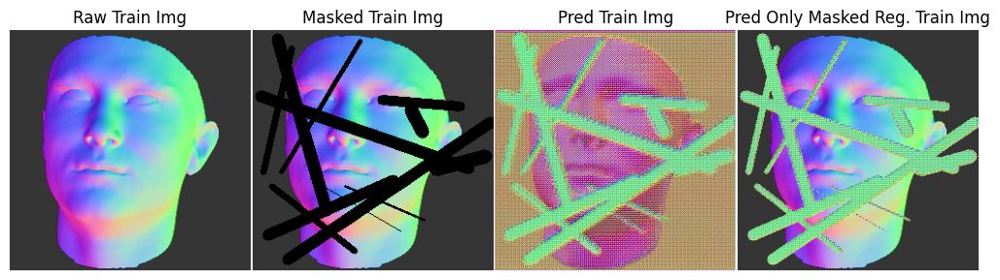

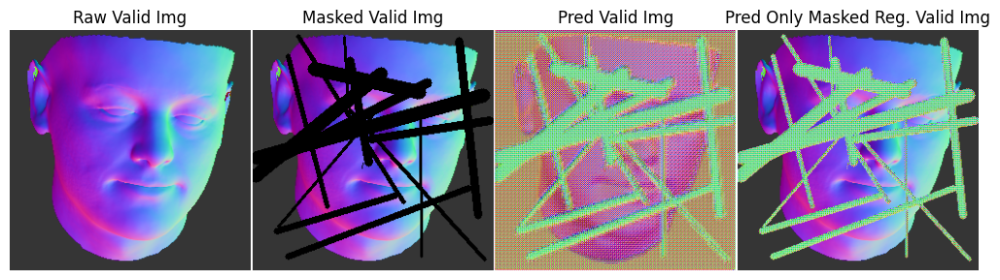

In [24]:
generator_plot_images(generator, 'Train', train_dataset, num = 1)
generator_plot_images(generator, 'Valid', valid_dataset, num = 1)

In [25]:
print("Generator Loss: ", generator_loss(fake_decision, raw_images_examples,pred_images_examples))
print("Generator SSIM: ", generator_ssim(raw_images_examples,pred_images_examples))
print("Generator PSNR: ", generator_psnr(raw_images_examples,pred_images_examples))

Generator Loss:  tf.Tensor(104.4305, shape=(), dtype=float32)
Generator SSIM:  tf.Tensor(-0.007980138, shape=(), dtype=float32)
Generator PSNR:  tf.Tensor(10.711304, shape=(), dtype=float32)


# Training Code Set

### Define Generator and Discriminator training steps for a batch

In [26]:
@tf.function
def train_generator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as gen_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=True)
        train_fake_output = discriminator(train_generated_images, training=False)
        gen_loss = generator_loss(train_fake_output, train_raw_images, train_generated_images)
        gen_ssim = generator_ssim(train_raw_images, train_generated_images)
        gen_psnr = generator_psnr(train_raw_images, train_generated_images)
        
    gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    
    return gradients, gen_loss, gen_ssim, gen_psnr

In [27]:
@tf.function
def train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images):
    with tf.GradientTape() as disc_tape:
        train_generated_images = generator([train_masked_images, train_mask_channels], training=False)
        train_real_output = discriminator(train_raw_images, training=True)
        train_fake_output = discriminator(train_generated_images, training=True)
        
        disc_loss = discriminator_loss(train_real_output, train_fake_output)
        disc_acc = discirminator_acc(train_real_output, train_fake_output)

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    return gradients, disc_loss, disc_acc

### Define a function to train a list of batches

In [28]:
def train_batches(batches_list, train_discriminator_first):
    gen_loss_total = 0
    gen_ssim_total = 0
    gen_psnr_total = 0
    disc_loss_total = 0
    disc_acc_total = 0

    # cumulative gradient
    accumulated_gen_gradients = [tf.zeros_like(var) for var in generator.trainable_variables]
    accumulated_disc_gradients = [tf.zeros_like(var) for var in discriminator.trainable_variables]
    
    for batch in batches_list:
        train_raw_images = batch
        train_mask_channels = mask_irregular(train_raw_images.shape[0], train_raw_images.shape[1], train_raw_images.shape[2])
        train_masked_images = masked_imgs(train_raw_images, train_mask_channels)
        
        # Train discriminator
        if train_discriminator_first:
            disc_gradients, disc_loss, disc_acc = train_discriminator_step(train_raw_images, train_mask_channels, train_masked_images)
            for i in range(len(accumulated_disc_gradients)):
                accumulated_disc_gradients[i] += disc_gradients[i]
            disc_loss_total += disc_loss.numpy()
            disc_acc_total += disc_acc.numpy()
            
        # Train generator
        else:
            gen_gradients, gen_loss, gen_ssim, gen_psnr = train_generator_step(train_raw_images, train_mask_channels, train_masked_images)
            for i in range(len(accumulated_gen_gradients)):
                accumulated_gen_gradients[i] += gen_gradients[i]
            gen_loss_total += gen_loss.numpy()
            gen_ssim_total += gen_ssim.numpy()
            gen_psnr_total += gen_psnr.numpy()

    # Applying accumulated gradients
    if train_discriminator_first:
        discriminator_optimizer.apply_gradients(zip(accumulated_disc_gradients, discriminator.trainable_variables))
    else:
        generator_optimizer.apply_gradients(zip(accumulated_gen_gradients, generator.trainable_variables))
    
    num_batches = len(batches_list)
    return (gen_loss_total / num_batches, gen_ssim_total / num_batches, gen_psnr_total / num_batches,
            disc_loss_total / num_batches, disc_acc_total / num_batches)

### Evaluate the function for the dataset

In [29]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_loss(fake_output, raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

### Processing batch data

In [30]:
def process_batches(dataset, batches_list_num, train_discriminator_first):
    train_dataset_batches_list = []
    epoch_metrics = {
        "train_gen_loss": [], "train_gen_ssim": [], "train_gen_psnr": [], 
        "train_disc_loss": [], "train_disc_acc": []
    }

    for i, images_batch in enumerate(dataset):
        train_dataset_batches_list.append(images_batch)
        if (i + 1) % batches_list_num == 0:
            batch_metrics = train_batches(train_dataset_batches_list, train_discriminator_first)
            train_dataset_batches_list = []
            for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    # Check for unprocessed batch
    if train_dataset_batches_list:
        batch_metrics = train_batches(train_dataset_batches_list, train_discriminator_first)
        train_dataset_batches_list = []
        for key, value in zip(epoch_metrics.keys(), batch_metrics):
                epoch_metrics[key].append(value)

    return epoch_metrics

### Record training information to CSV file

In [31]:
def record_training_info(log_file, current_epoch, metrics_lists, elapsed_time):
    with open(log_file, "a", newline='') as file:
        writer = csv.writer(file)
        if os.stat(log_file).st_size == 0:
            writer.writerow(["Epoch"] + list(metrics_lists.keys()) + ["Elapsed Time (Seconds)"])

        writer.writerow([current_epoch] + [sum(metrics) / len(metrics) for metrics in metrics_lists.values()] + [elapsed_time])

### Print training information

In [32]:
def print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, training_module, checkpoint_message):
    print(f"Epoch {current_epoch}/{total_epochs}  "
          f"Train[G_Loss:{metrics_lists['train_gen_loss'][-1]:.5f} SSIM:{metrics_lists['train_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['train_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['train_disc_loss'][-1]:.5f} {metrics_lists['train_disc_acc'][-1] * 100:.3f}%]  "
          f"Valid[G_Loss:{metrics_lists['valid_gen_loss'][-1]:.5f} SSIM:{metrics_lists['valid_gen_ssim'][-1] * 100:.2f}% PSNR:{metrics_lists['valid_gen_psnr'][-1]:.2f} "
          f"Disc:{metrics_lists['valid_disc_loss'][-1]:.5f} {metrics_lists['valid_disc_acc'][-1] * 100:.3f}%] "
          f"- {elapsed_time:.0f}s - Training: {'Discriminator' if training_module else 'Generator'} {checkpoint_message}")

### Charting metrics

In [33]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['valid_disc_loss'], metrics_lists['valid_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [34]:
def load_metrics_from_csv(log_file):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'valid_gen_loss': [], 'valid_gen_ssim': [], 'valid_gen_psnr': [],
        'valid_disc_loss': [], 'valid_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    metrics_lists[key].append(float(row[key]))

    return metrics_lists

### Save checkpoints

In [35]:
checkpoint_dir = './training_checkpoints'
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_dir, max_to_keep=1)

### Restore the latest saved checkpoint (if exist)

In [36]:
checkpoint.restore(checkpoint_manager.latest_checkpoint)

### Restoring Training Logs from Previous Sessions

In [37]:
def display_saved_images(epoch, image_path='./saved_images'):
    train_image_path = os.path.join(image_path, f'Train_epoch_{epoch}.png')
    test_image_path = os.path.join(image_path, f'Valid_epoch_{epoch}.png')

    if os.path.exists(train_image_path):
        train_image = mpimg.imread(train_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(train_image)
        plt.axis('off')
        plt.show()

    if os.path.exists(valid_image_path):
        valid_image = mpimg.imread(valid_image_path)
        plt.figure(figsize=(12, 9), dpi=300)
        plt.imshow(valid_image)
        plt.axis('off')
        plt.show()

In [38]:
def load_metrics_until_epoch(log_file, epoch):
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'valid_gen_loss': [], 'valid_gen_ssim': [], 'valid_gen_psnr': [],
        'valid_disc_loss': [], 'valid_disc_acc': []
    }

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                if int(row['Epoch']) <= epoch:
                    for key in metrics_lists.keys():
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists

In [39]:
def read_last_epoch(log_file, total_epochs, epoch_break, training_module):
    last_valid_epoch = 0
    cleaned_data = []

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            rows = list(csv.reader(file))
            header = rows[0]
            data_rows = rows[1:]

            # Find a multiple of the last epoch_break
            for row in reversed(data_rows):
                epoch = int(row[0])
                if epoch % epoch_break == 0:
                    last_valid_epoch = epoch
                    cleaned_data = data_rows[:data_rows.index(row) + 1]
                    break

            #  If a matching epoch is found, rewrite the file
            if cleaned_data:
                with open(log_file, "w", newline='') as file:
                    writer = csv.writer(file)
                    writer.writerow(header)
                    writer.writerows(cleaned_data)

            # Reprint previous training information
            for data in cleaned_data:
                current_epoch = int(data[0])
                elapsed_time = float(data[-1])
                metrics_lists = {
                    'train_gen_loss': [float(data[1])],
                    'train_gen_ssim': [float(data[2])],
                    'train_gen_psnr': [float(data[3])],
                    'train_disc_loss': [float(data[4])],
                    'train_disc_acc': [float(data[5])],
                    'valid_gen_loss': [float(data[6])],
                    'valid_gen_ssim': [float(data[7])],
                    'valid_gen_psnr': [float(data[8])],
                    'valid_disc_loss': [float(data[9])],
                    'valid_disc_acc': [float(data[10])]
                }
                print_training_info(current_epoch, total_epochs, metrics_lists, elapsed_time, training_module)

                if current_epoch % epoch_break == 0:
                    display_saved_images(current_epoch)
                    plot_metrics(load_metrics_until_epoch(log_file, current_epoch))

    return last_valid_epoch

### Training

In [40]:
class ModelCheckpoint:
    def __init__(self, checkpoint_manager, gen_filepath, disc_filepath, monitor='val_loss', verbose=False):
        self.checkpoint_manager = checkpoint_manager
        self.gen_filepath = gen_filepath
        self.disc_filepath = disc_filepath
        self.monitor = monitor
        self.verbose = verbose
        self.best_val = float('inf')

    def on_epoch_end(self, epoch, current_val, generator, discriminator):
        message = ""
        if current_val < self.best_val:
            self.best_val = current_val
            generator.save(self.gen_filepath)
            discriminator.save(self.disc_filepath)
            self.checkpoint_manager.save()
            if self.verbose:
                message = f"Checkpoint&Models saved (epoch {epoch + 1})"
        return message

In [41]:
def train(train_dataset, valid_dataset, max_epochs, epoch_break, batches_list_num, generator, discriminator, early_stopping_rounds):
    
    log_dir = './saved_logs'
    os.makedirs(log_dir, exist_ok=True)
    log_file = os.path.join(log_dir, "GAN_training_results.csv")
    
    # Read the last completed epoch
    start_epoch = read_last_epoch(log_file, max_epochs, epoch_break, True)
    
    metrics_lists = {
        'train_gen_loss': [], 'train_gen_ssim': [], 'train_gen_psnr': [],
        'train_disc_loss': [], 'train_disc_acc': [],
        'valid_gen_loss': [], 'valid_gen_ssim': [], 'valid_gen_psnr': [],
        'valid_disc_loss': [], 'valid_disc_acc': []
    }

    model_checkpoint = ModelCheckpoint(
        checkpoint_manager=checkpoint_manager,
        gen_filepath='./saved_model/generator_best.h5',
        disc_filepath='./saved_model/discriminator_best.h5',
        monitor='valid_gen_loss', verbose=True
    )

    train_discriminator_first = True
    EPSILON = 1e-10
    DISC_LOSS_THRESHOLD = 0.01  
    DISC_ACC_THRESHOLD = 1.0
    DISC_ACC_BALANCE_THRESHOLD = 0.50
    best_valid_disc_loss = float('inf')
    best_valid_gen_loss = float('inf')
    no_improvement_rounds = 0
    generator_first_epoch = True

        
    for epoch in range(start_epoch, max_epochs):
        start_time = time.time()

        # # For Train
        epoch_metrics = process_batches(train_dataset, batches_list_num, train_discriminator_first)
        for key in epoch_metrics.keys():
            metrics_lists[key].append(sum(epoch_metrics[key]) / len(epoch_metrics[key]))
                    
        # For valid
        valid_metrics = assessment(valid_dataset)
        for key, value in valid_metrics.items():
            metrics_lists['valid_' + key].append(value)
        
        # Save Training Information
        current_epoch = epoch + 1
        elapsed_time = time.time() - start_time
        record_training_info(log_file, current_epoch, metrics_lists, elapsed_time)


        current_disc_loss = metrics_lists['valid_disc_loss'][-1]
        current_gen_loss = metrics_lists['valid_gen_loss'][-1]
        current_disc_acc = metrics_lists['valid_disc_acc'][-1]

        # Early stopping check for current training
        if train_discriminator_first:
            # Check for discriminator improvements
            if current_disc_loss < best_valid_disc_loss and current_disc_loss > EPSILON:
                best_valid_disc_loss = current_disc_loss
                no_improvement_rounds = 0
            else:
                no_improvement_rounds += 1

            # Toggle the training order if no improvement
            if no_improvement_rounds >= early_stopping_rounds or abs(current_disc_acc - DISC_ACC_THRESHOLD) < 0.05:
                train_discriminator_first = not train_discriminator_first
                no_improvement_rounds = 0
                generator_training_rounds_without_improvement = 0  # Reset the counter for generator
                generator_first_epoch = True  # Reset the first epoch flag of generator training
        else:
            # Check for generator improvements
            current_gen_loss = metrics_lists['valid_gen_loss'][-1]
            if current_gen_loss < best_valid_gen_loss and current_gen_loss > EPSILON:
                best_valid_gen_loss = current_gen_loss
                no_improvement_rounds = 0
                generator_first_epoch = False
            else:
                no_improvement_rounds += 1

            # If it is the first 10 epochs of generator training and consecutively unimproved, stop training
            if generator_first_epoch and no_improvement_rounds >= early_stopping_rounds:
                print(f"No improvement in generator loss for first {early_stopping_rounds} trainings, stopping training.")
                break
            
            if no_improvement_rounds >= early_stopping_rounds or abs(current_disc_acc - DISC_ACC_BALANCE_THRESHOLD) < 0.05:
                train_discriminator_first = not train_discriminator_first
                no_improvement_rounds = 0
            

        # Check and save best model
        current_val = metrics_lists['valid_gen_loss'][-1]
        checkpoint_message = model_checkpoint.on_epoch_end(epoch, current_val, generator, discriminator)
    
        # Print Training Information
        print_training_info(current_epoch, max_epochs, metrics_lists, elapsed_time, train_discriminator_first, checkpoint_message)
        
        # Epoch output results with set intervals
        if (epoch + 1) % epoch_break == 0:
            
            generator_plot_images(generator, 'Train', train_dataset, epoch=current_epoch, save_images=True)
            generator_plot_images(generator, 'valid', valid_dataset, epoch=current_epoch, save_images=True)

            plot_metrics(load_metrics_from_csv(log_file))

Epoch 1/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.14485 96.458%]  Valid[G_Loss:93.67593 SSIM:0.76% PSNR:10.75 Disc:0.60225 99.716%] - 14s - Training: Generator Checkpoint&Models saved (epoch 1)
Epoch 2/10000  Train[G_Loss:35.72832 SSIM:10.53% PSNR:11.40 Disc:0.00000 0.000%]  Valid[G_Loss:72.78460 SSIM:8.14% PSNR:11.11 Disc:0.79494 50.000%] - 13s - Training: Discriminator Checkpoint&Models saved (epoch 2)
Epoch 3/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:3.28163 85.382%]  Valid[G_Loss:77.29520 SSIM:8.16% PSNR:11.11 Disc:0.04570 99.148%] - 5s - Training: Generator 
Epoch 4/10000  Train[G_Loss:14.71816 SSIM:16.19% PSNR:11.64 Disc:0.00000 0.000%]  Valid[G_Loss:73.25356 SSIM:8.07% PSNR:11.12 Disc:0.05216 99.148%] - 8s - Training: Generator 
Epoch 5/10000  Train[G_Loss:10.60623 SSIM:17.01% PSNR:11.66 Disc:0.00000 0.000%]  Valid[G_Loss:44.49962 SSIM:11.26% PSNR:11.39 Disc:0.05678 99.148%] - 8s - Training: Generator Checkpoint&Models saved (epoch 5)
Epoch 6/10000  Tra

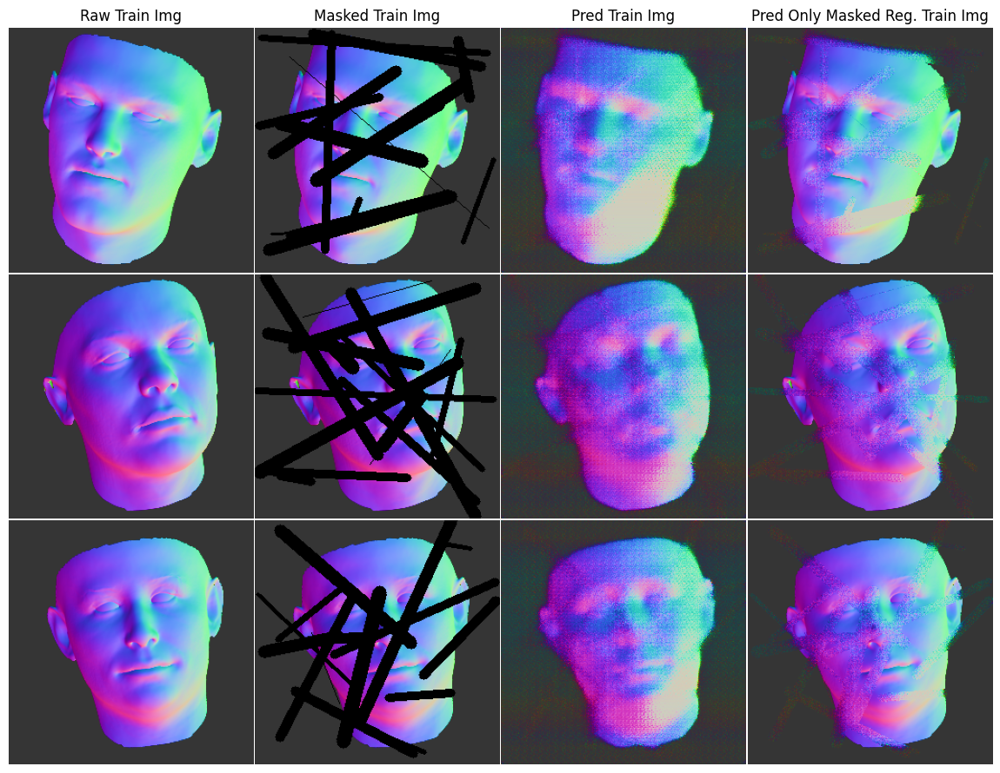

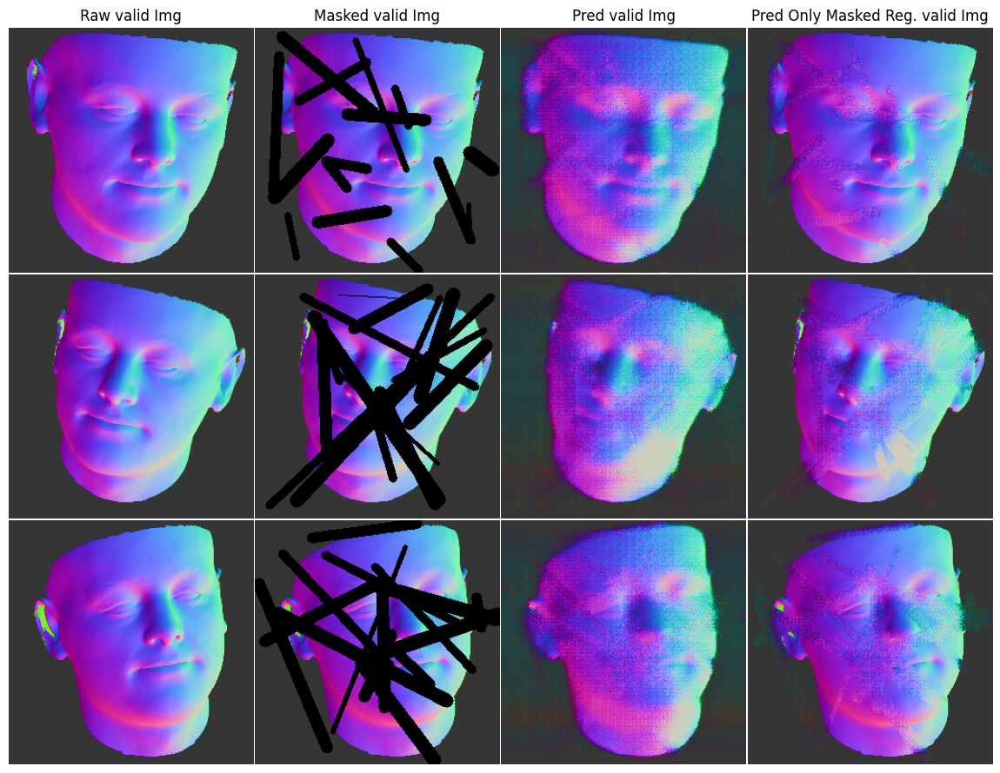

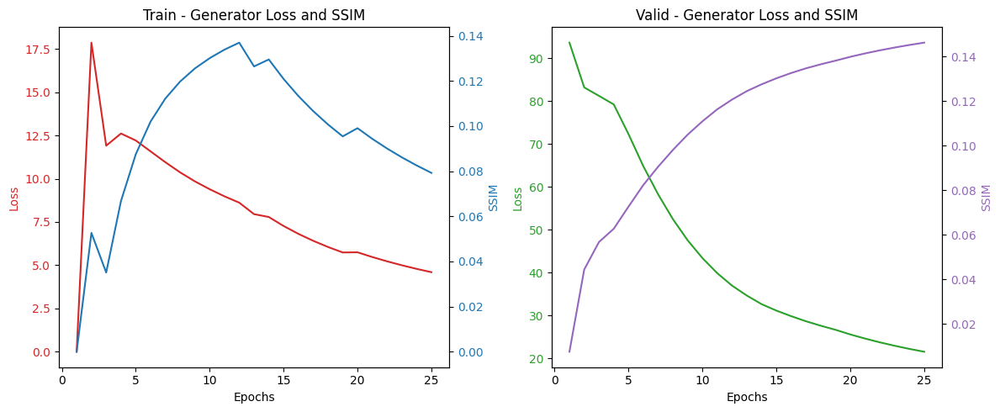

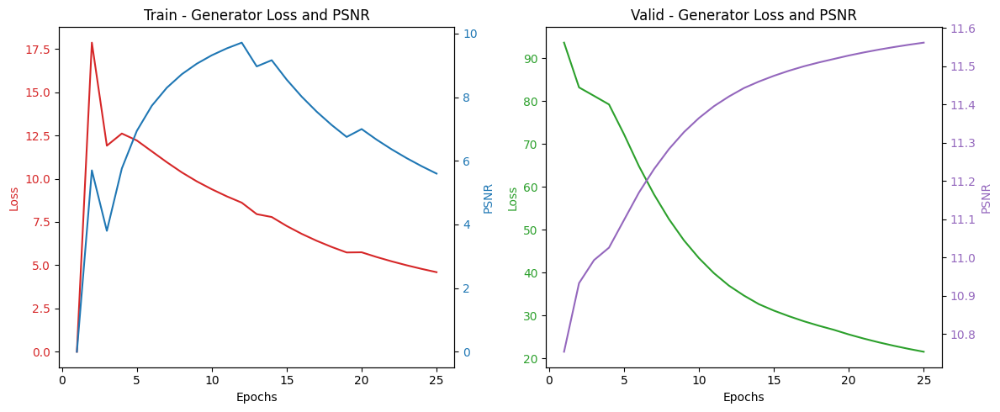

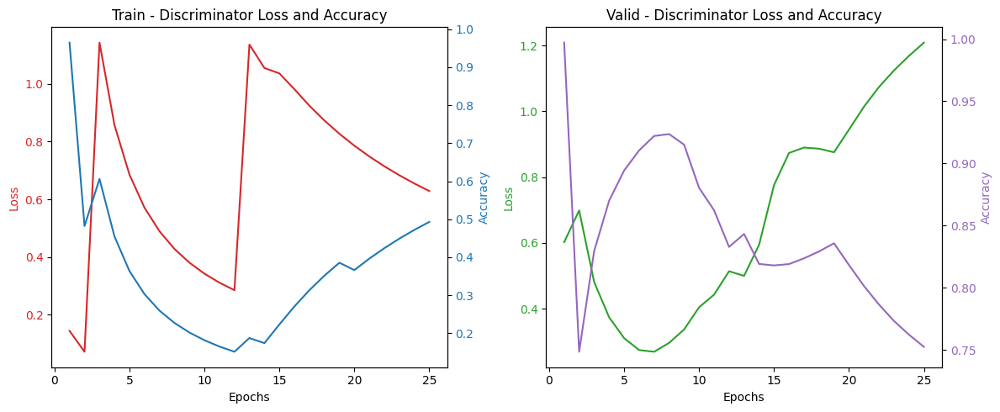

Epoch 26/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00017 100.000%]  Valid[G_Loss:5.35047 SSIM:17.21% PSNR:11.70 Disc:2.07428 51.136%] - 5s - Training: Discriminator 
Epoch 27/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00014 100.000%]  Valid[G_Loss:5.14320 SSIM:17.26% PSNR:11.70 Disc:2.02399 51.989%] - 5s - Training: Discriminator 
Epoch 28/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00015 100.000%]  Valid[G_Loss:5.73750 SSIM:17.07% PSNR:11.69 Disc:2.06450 50.568%] - 5s - Training: Discriminator 
Epoch 29/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00025 100.000%]  Valid[G_Loss:5.25842 SSIM:17.24% PSNR:11.70 Disc:1.98428 53.693%] - 5s - Training: Discriminator 
Epoch 30/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00011 100.000%]  Valid[G_Loss:5.36978 SSIM:17.21% PSNR:11.70 Disc:1.98145 52.841%] - 5s - Training: Discriminator 
Epoch 31/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00010 100.000%]  Valid[G_Loss:5.612

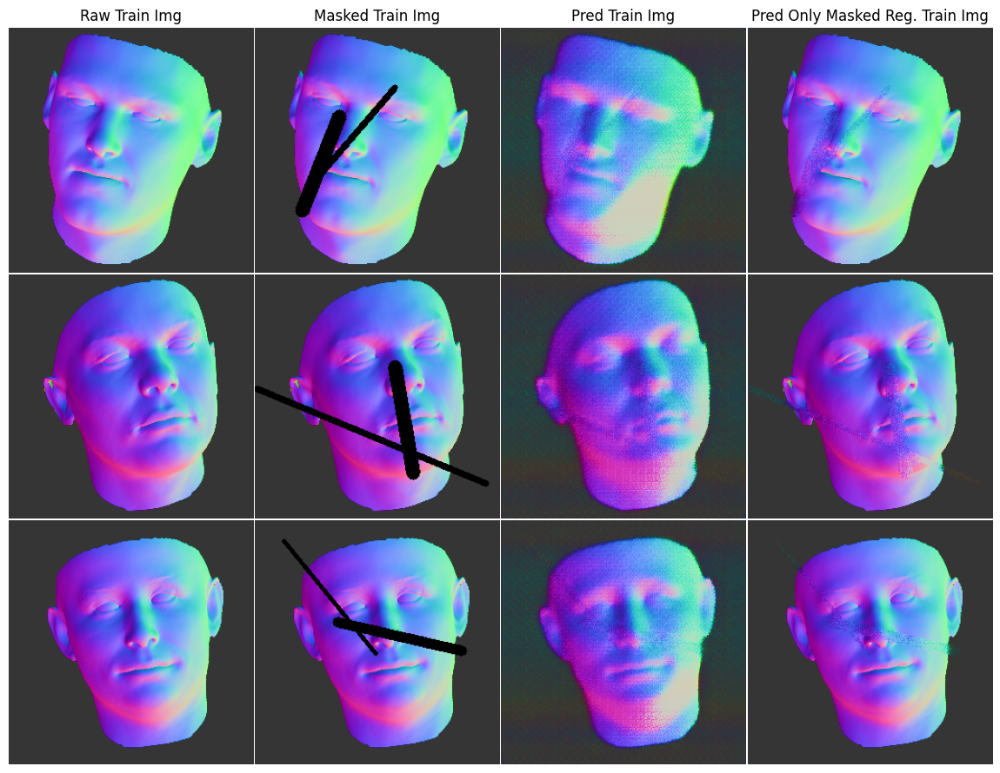

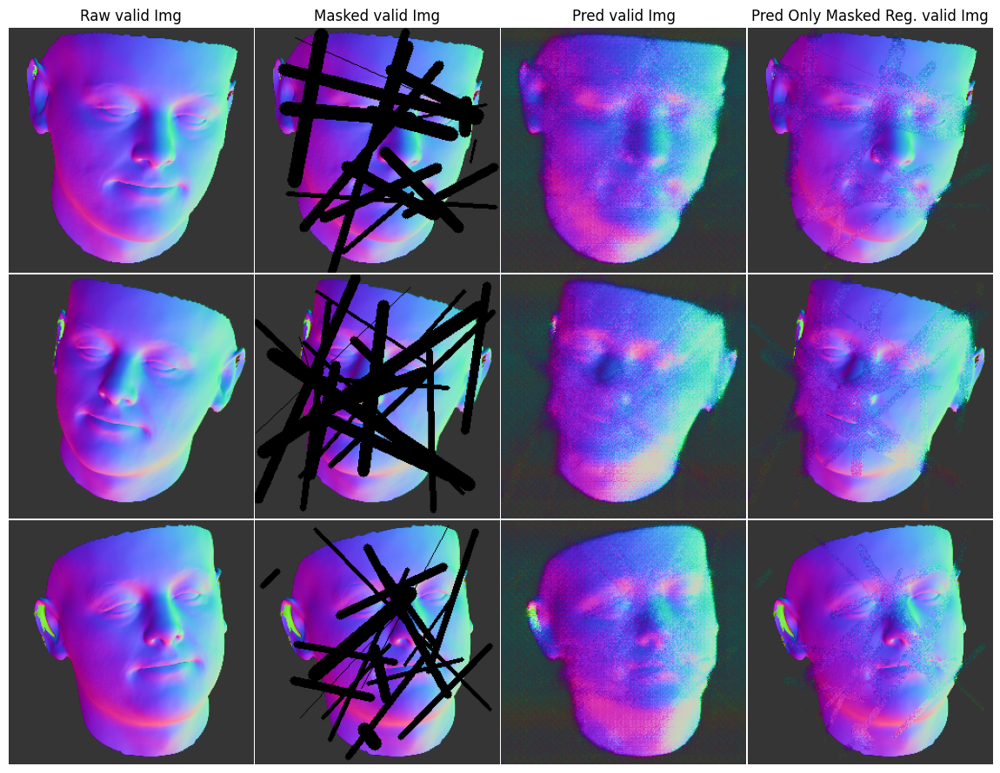

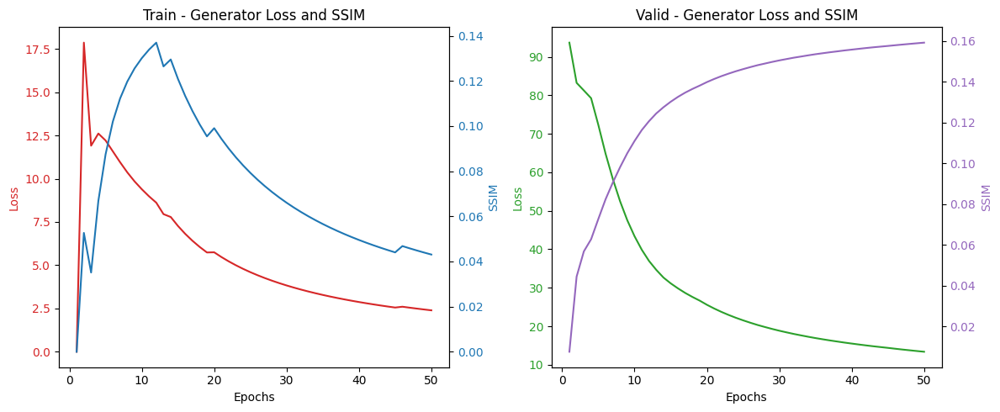

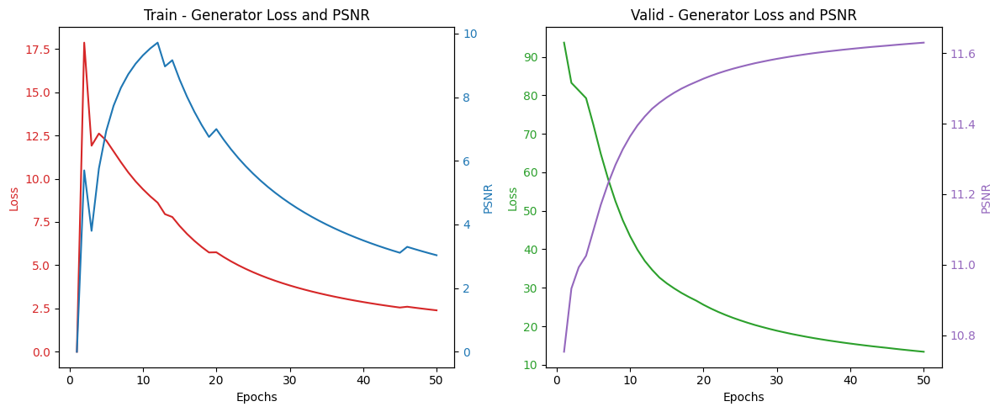

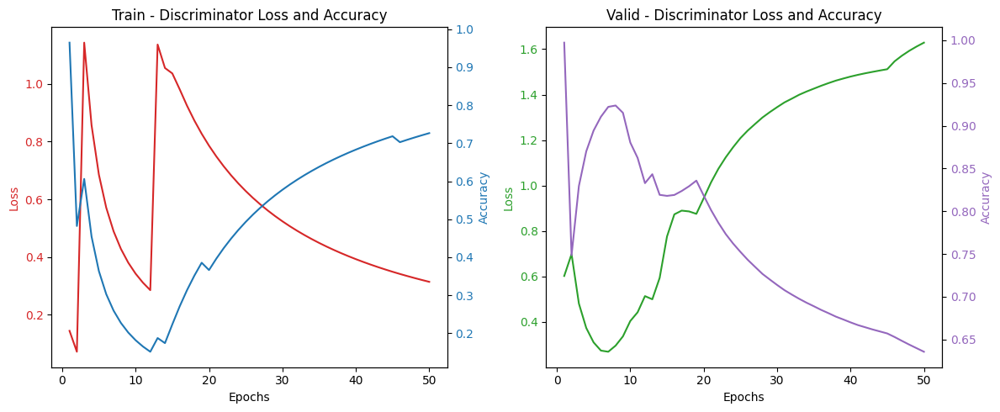

Epoch 51/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00010 100.000%]  Valid[G_Loss:4.68238 SSIM:17.31% PSNR:11.70 Disc:2.49293 44.034%] - 5s - Training: Discriminator 
Epoch 52/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00011 100.000%]  Valid[G_Loss:4.42791 SSIM:17.39% PSNR:11.71 Disc:2.40088 44.602%] - 5s - Training: Discriminator 
Epoch 53/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00011 100.000%]  Valid[G_Loss:4.24175 SSIM:17.42% PSNR:11.71 Disc:2.37959 43.750%] - 5s - Training: Discriminator 
Epoch 54/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00008 100.000%]  Valid[G_Loss:4.36255 SSIM:17.39% PSNR:11.71 Disc:2.36624 43.750%] - 5s - Training: Discriminator 
Epoch 55/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00008 100.000%]  Valid[G_Loss:4.41870 SSIM:17.39% PSNR:11.71 Disc:2.34852 45.739%] - 5s - Training: Discriminator 
Epoch 56/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00007 100.000%]  Valid[G_Loss:4.313

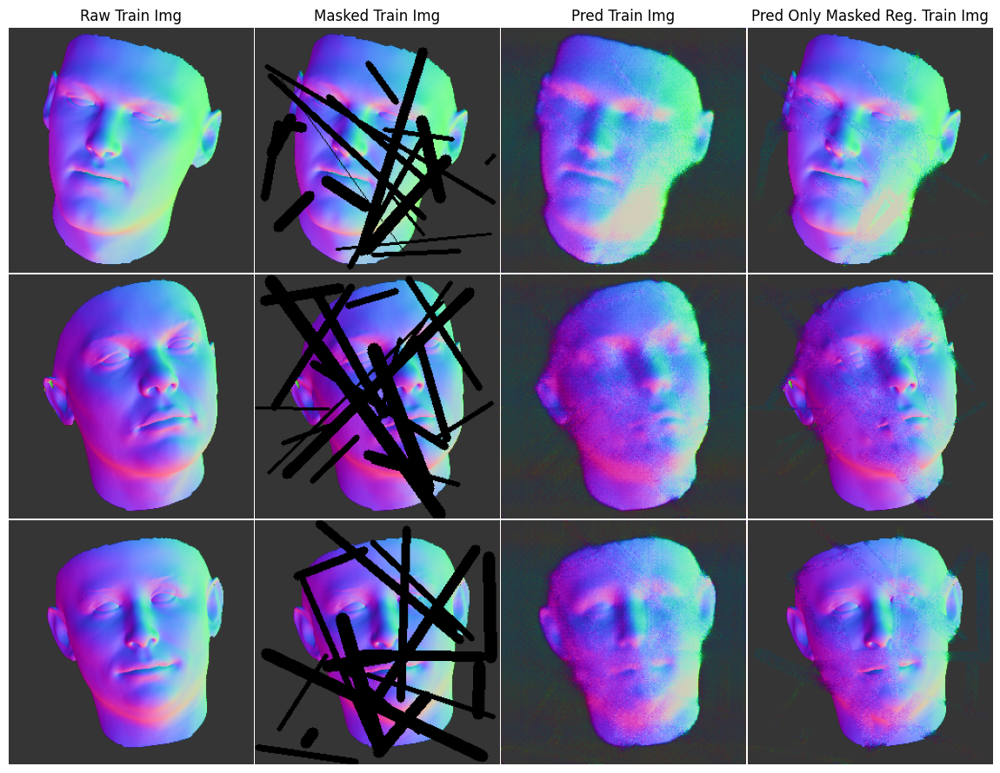

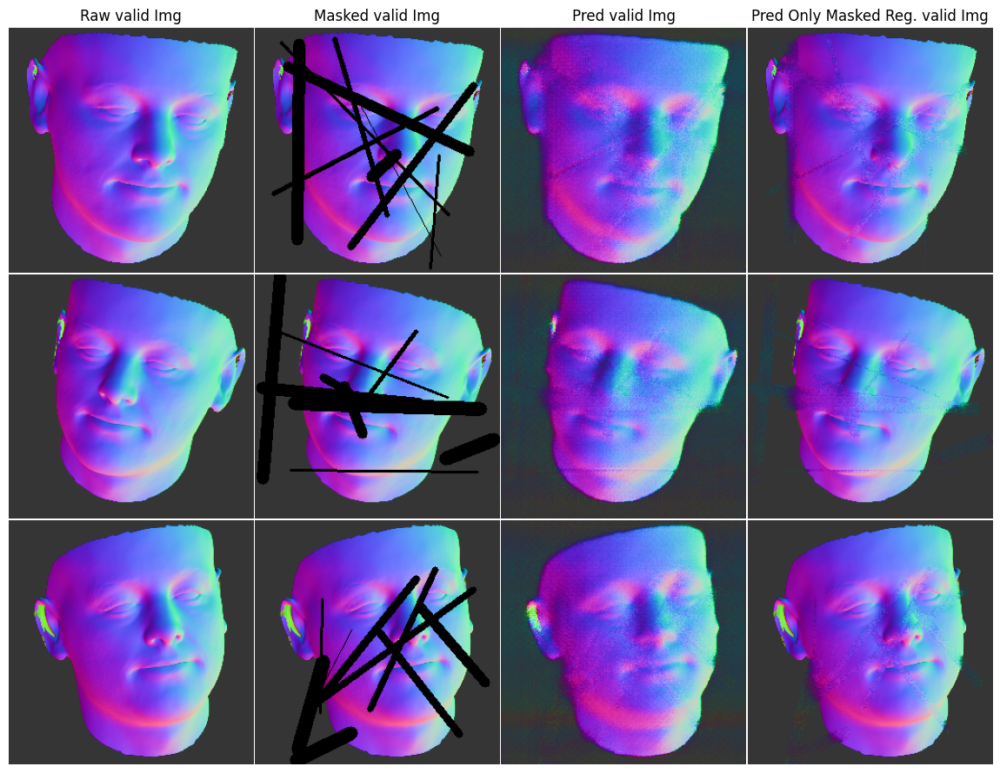

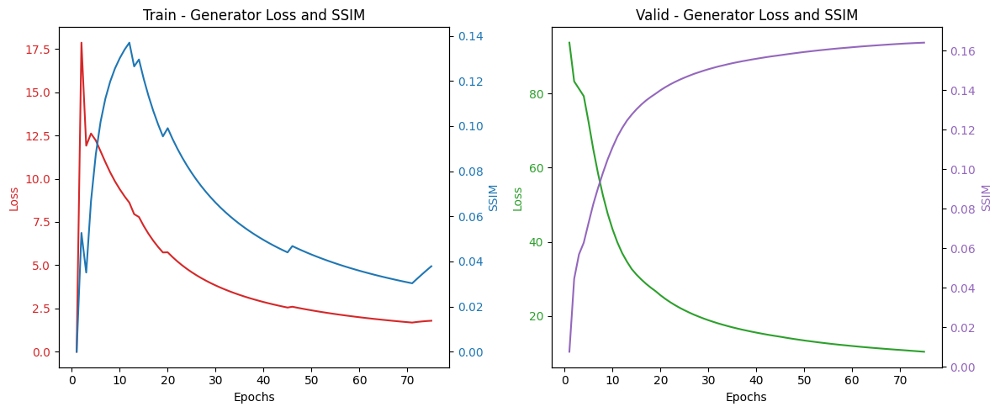

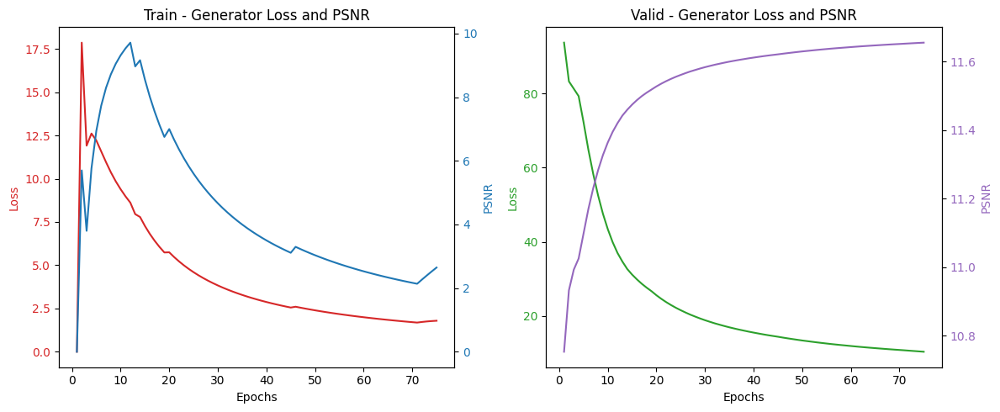

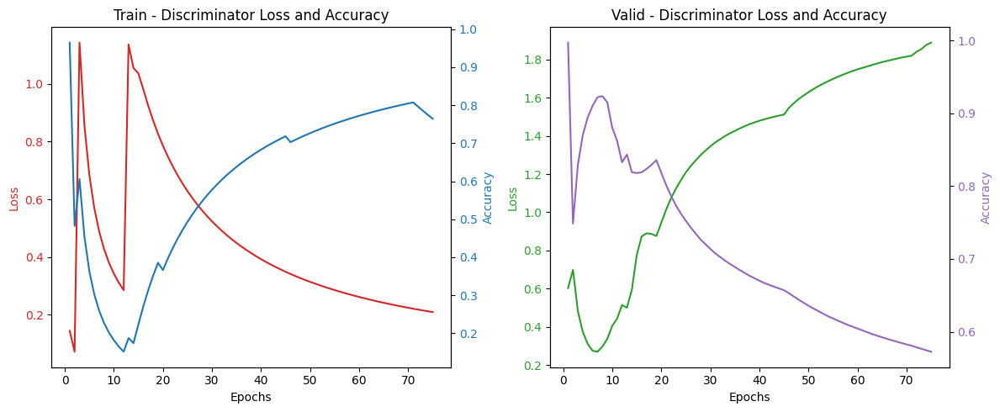

Epoch 76/10000  Train[G_Loss:2.99902 SSIM:17.16% PSNR:11.71 Disc:0.00000 0.000%]  Valid[G_Loss:2.72288 SSIM:17.20% PSNR:11.71 Disc:3.43286 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 76)
Epoch 77/10000  Train[G_Loss:2.92526 SSIM:17.14% PSNR:11.71 Disc:0.00000 0.000%]  Valid[G_Loss:2.84705 SSIM:17.17% PSNR:11.71 Disc:3.01924 42.330%] - 8s - Training: Generator 
Epoch 78/10000  Train[G_Loss:2.73721 SSIM:17.15% PSNR:11.71 Disc:0.00000 0.000%]  Valid[G_Loss:2.78813 SSIM:17.13% PSNR:11.71 Disc:3.50828 42.330%] - 7s - Training: Generator 
Epoch 79/10000  Train[G_Loss:2.67186 SSIM:17.10% PSNR:11.71 Disc:0.00000 0.000%]  Valid[G_Loss:2.67582 SSIM:17.10% PSNR:11.71 Disc:3.39174 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 79)
Epoch 80/10000  Train[G_Loss:2.49249 SSIM:17.09% PSNR:11.71 Disc:0.00000 0.000%]  Valid[G_Loss:2.29791 SSIM:17.08% PSNR:11.71 Disc:3.60765 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 80)
Epoch 81/10000  Tr

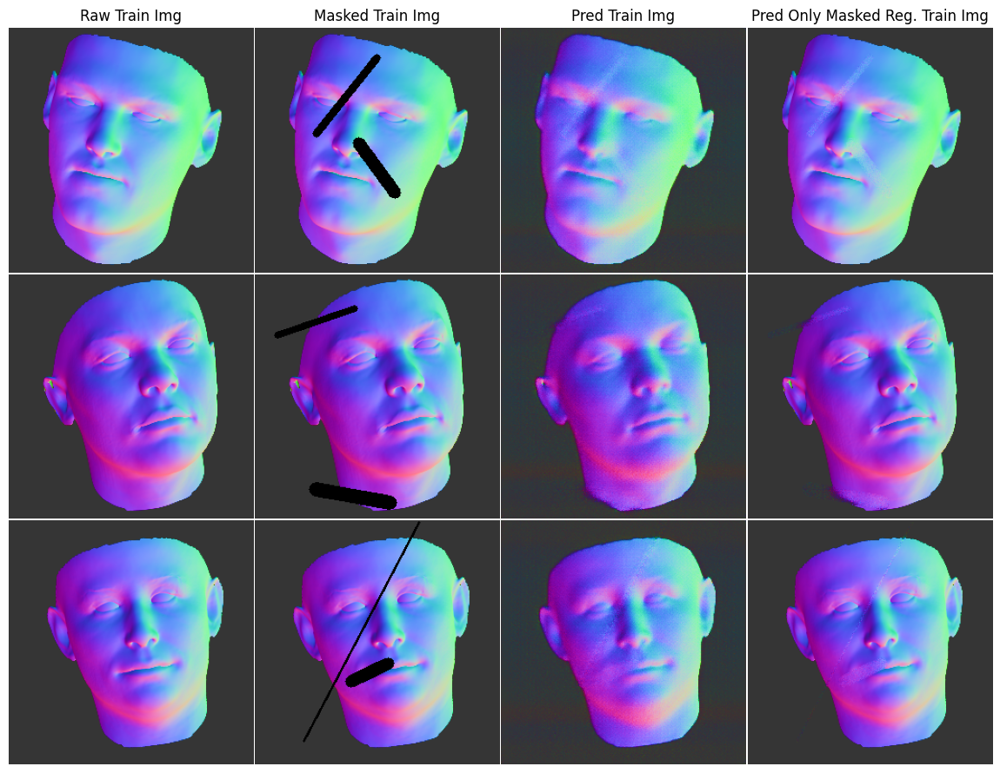

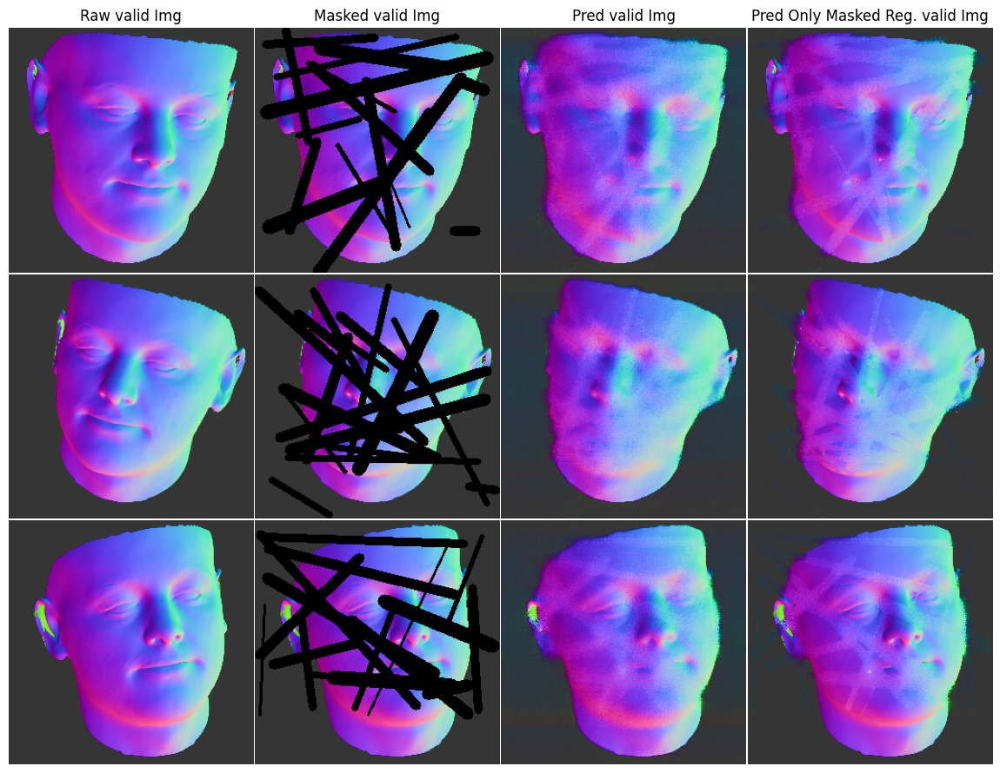

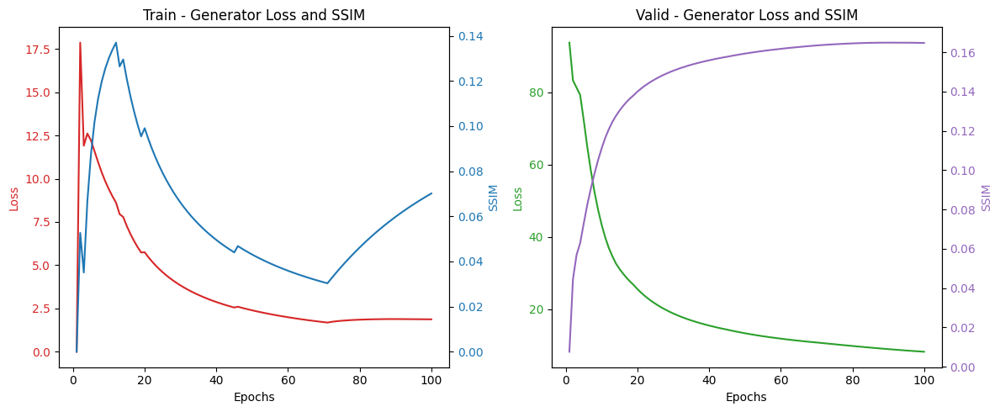

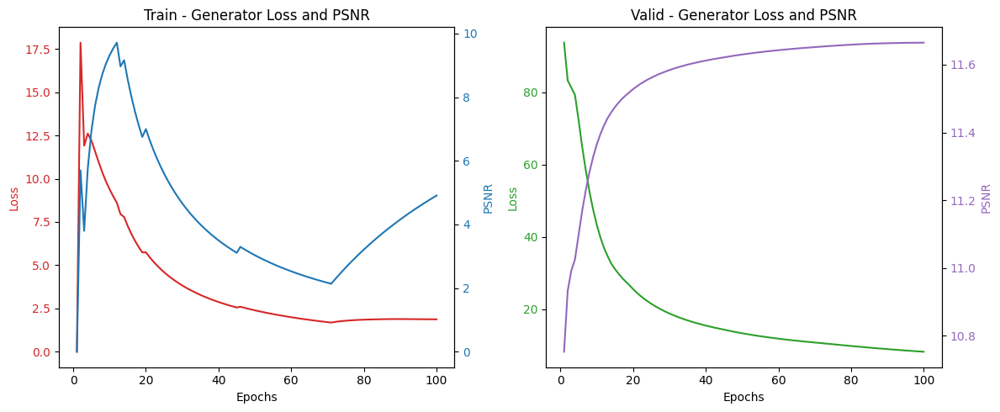

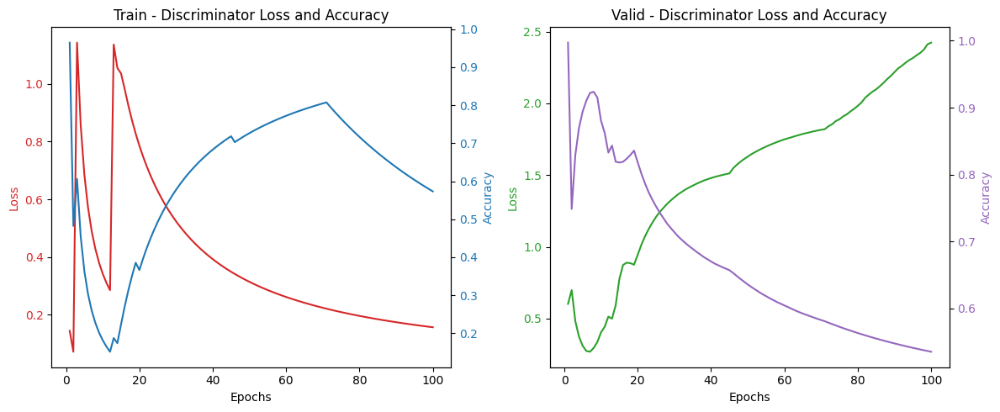

Epoch 101/10000  Train[G_Loss:1.64312 SSIM:16.29% PSNR:11.68 Disc:0.00000 0.000%]  Valid[G_Loss:2.02369 SSIM:16.02% PSNR:11.68 Disc:5.80828 42.330%] - 8s - Training: Generator 
Epoch 102/10000  Train[G_Loss:1.67834 SSIM:16.14% PSNR:11.68 Disc:0.00000 0.000%]  Valid[G_Loss:1.46905 SSIM:16.17% PSNR:11.67 Disc:3.78049 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 102)
Epoch 103/10000  Train[G_Loss:1.46737 SSIM:16.13% PSNR:11.67 Disc:0.00000 0.000%]  Valid[G_Loss:1.61611 SSIM:15.98% PSNR:11.67 Disc:4.61519 42.330%] - 8s - Training: Generator 
Epoch 104/10000  Train[G_Loss:1.48699 SSIM:16.00% PSNR:11.67 Disc:0.00000 0.000%]  Valid[G_Loss:1.36107 SSIM:16.03% PSNR:11.67 Disc:3.99955 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 104)
Epoch 105/10000  Train[G_Loss:1.52298 SSIM:15.97% PSNR:11.67 Disc:0.00000 0.000%]  Valid[G_Loss:1.17644 SSIM:15.94% PSNR:11.67 Disc:5.11077 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 105)
Epoch 106/

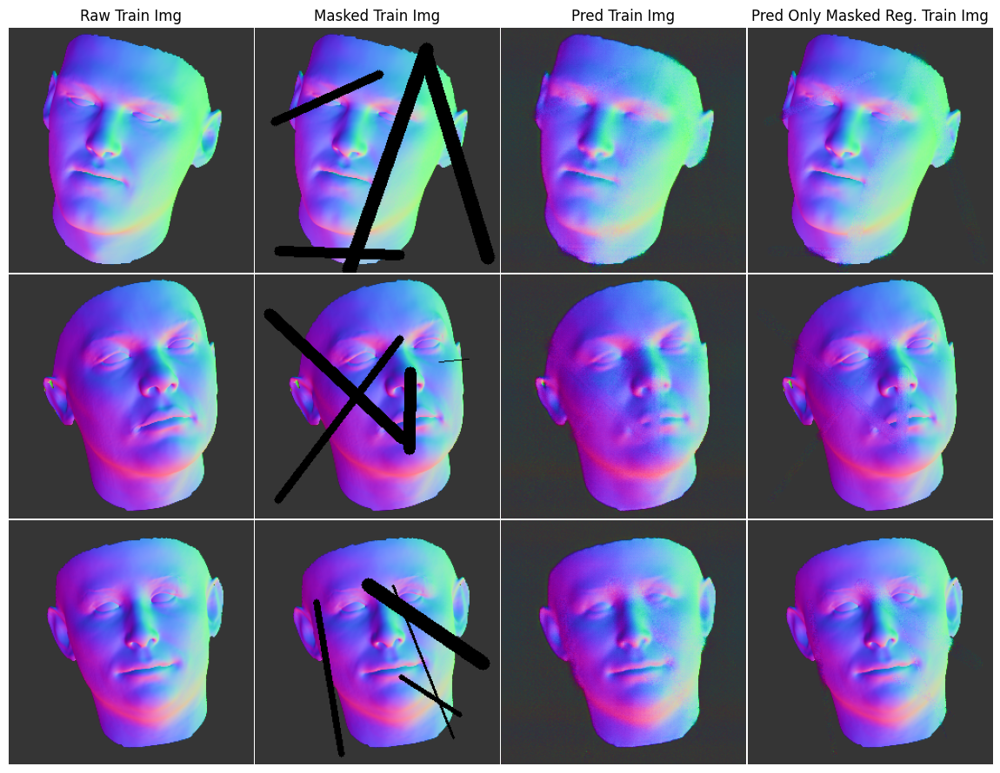

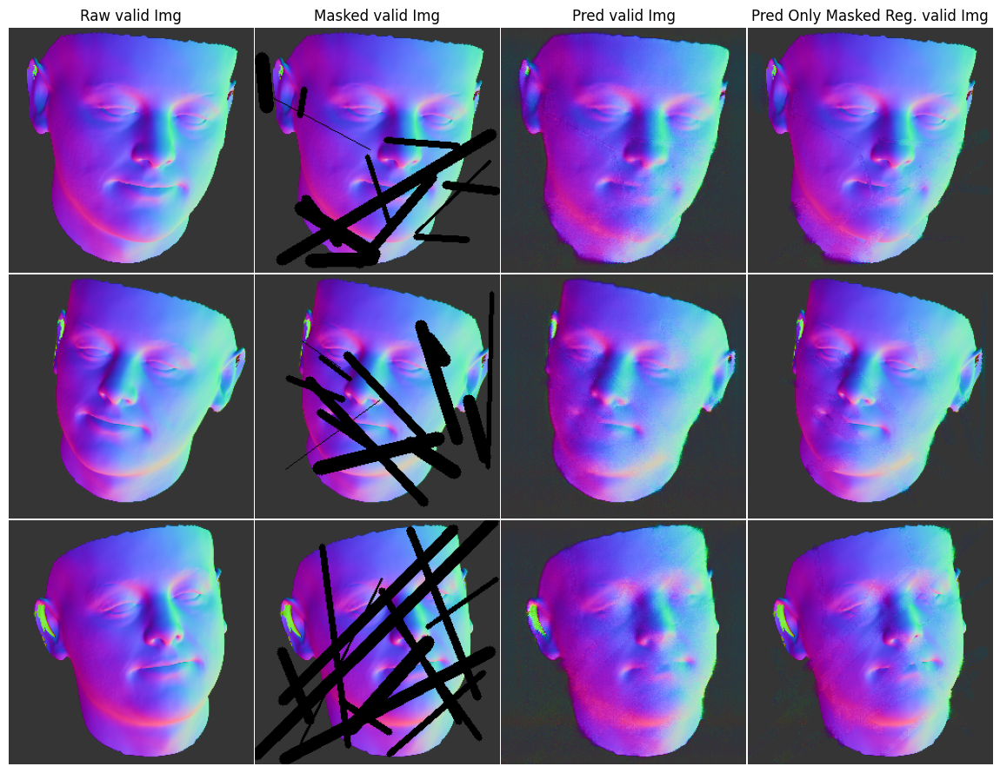

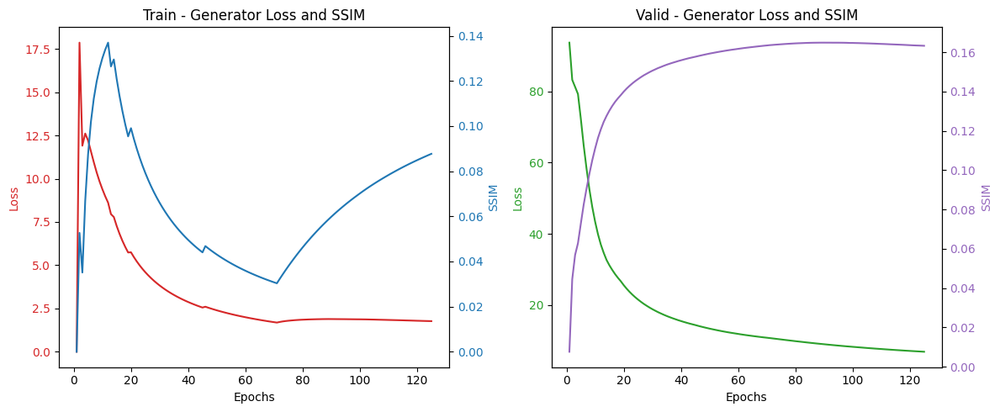

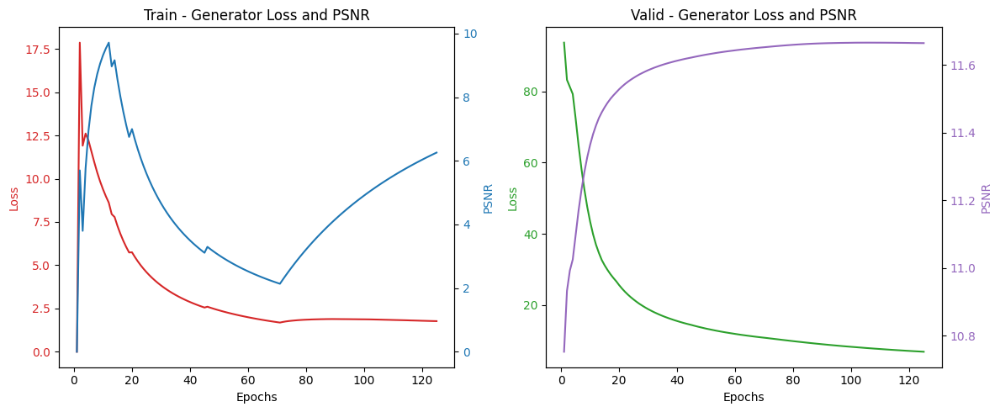

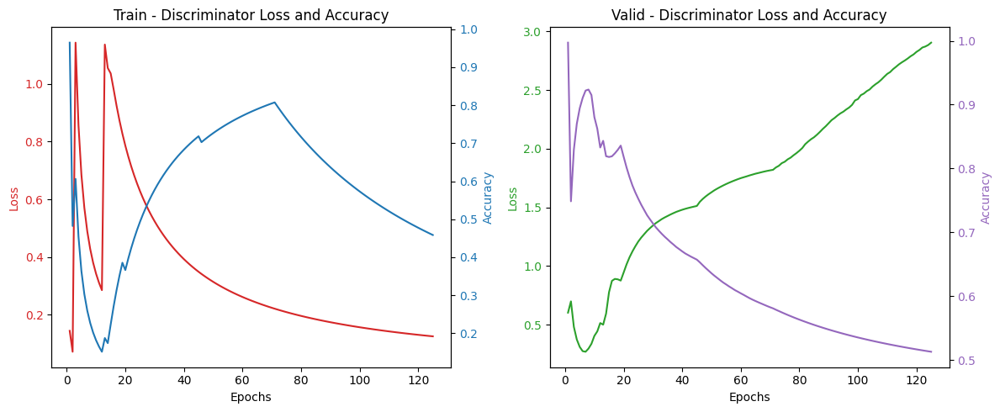

Epoch 126/10000  Train[G_Loss:1.16778 SSIM:15.52% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.13306 SSIM:15.34% PSNR:11.65 Disc:5.25044 42.330%] - 8s - Training: Generator 
Epoch 127/10000  Train[G_Loss:1.20444 SSIM:15.43% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.14832 SSIM:15.34% PSNR:11.65 Disc:5.56845 42.330%] - 8s - Training: Generator 
Epoch 128/10000  Train[G_Loss:1.18935 SSIM:15.39% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.01845 SSIM:15.40% PSNR:11.64 Disc:4.74222 42.330%] - 8s - Training: Generator 
Epoch 129/10000  Train[G_Loss:1.17568 SSIM:15.36% PSNR:11.64 Disc:0.00000 0.000%]  Valid[G_Loss:1.21011 SSIM:15.19% PSNR:11.64 Disc:5.60718 42.330%] - 8s - Training: Generator 
Epoch 130/10000  Train[G_Loss:1.16500 SSIM:15.38% PSNR:11.64 Disc:0.00000 0.000%]  Valid[G_Loss:1.24440 SSIM:15.34% PSNR:11.64 Disc:4.66012 42.330%] - 8s - Training: Generator 
Epoch 131/10000  Train[G_Loss:1.14500 SSIM:15.36% PSNR:11.64 Disc:0.00000 0.000%]  Valid[G_Loss:1.10203 SSIM:15.26%

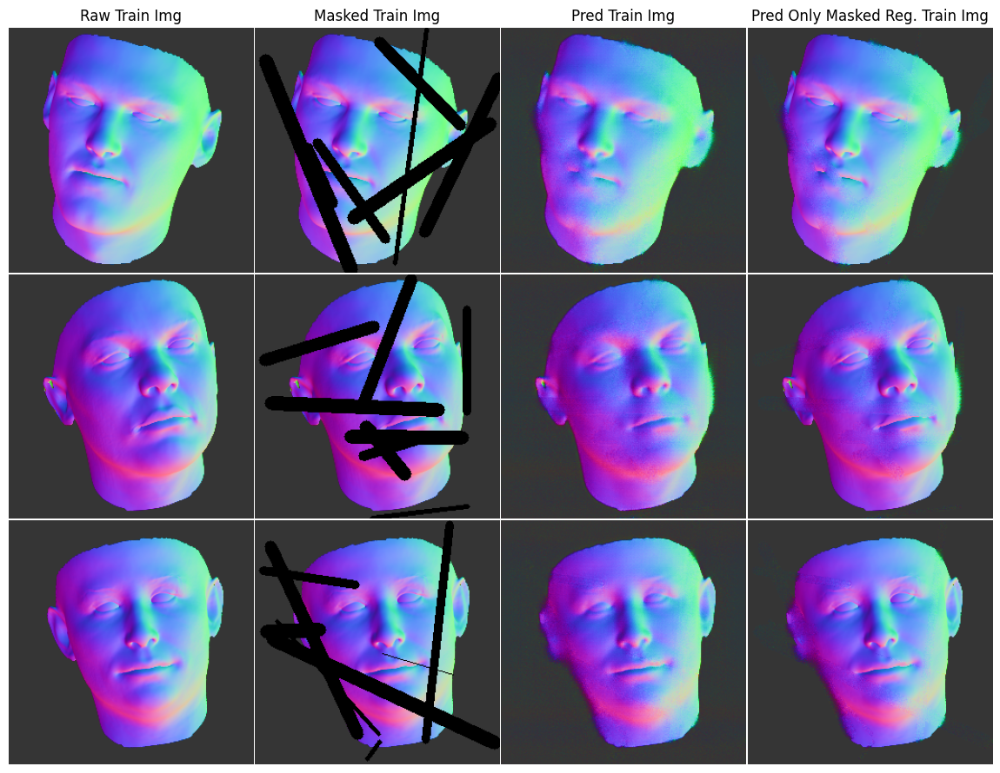

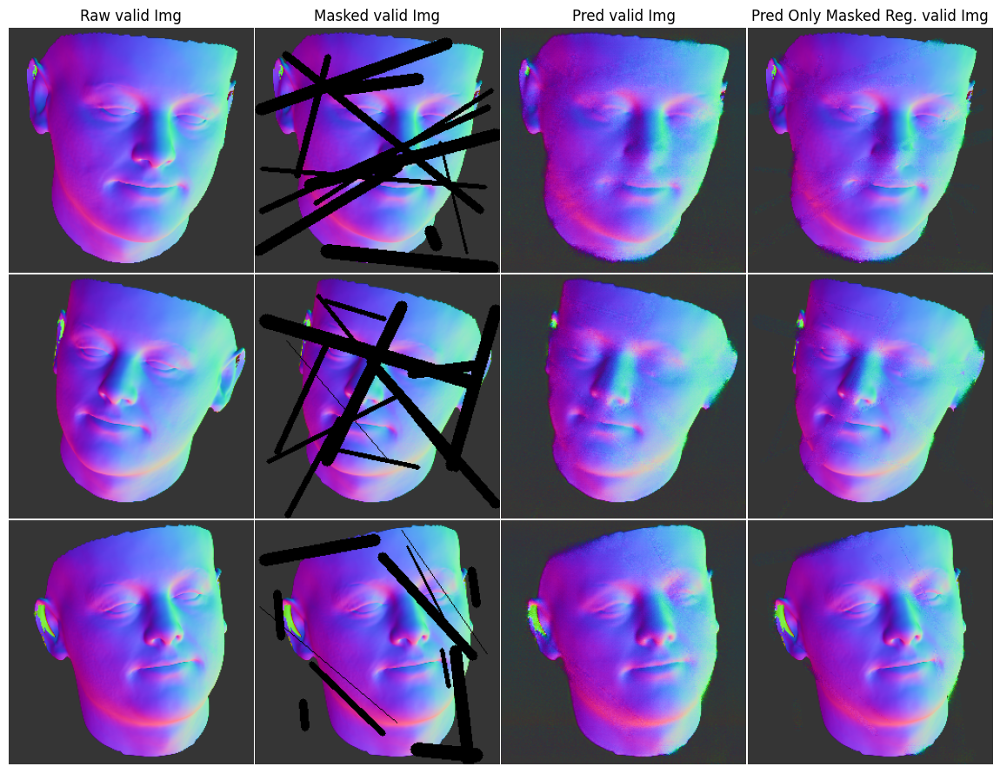

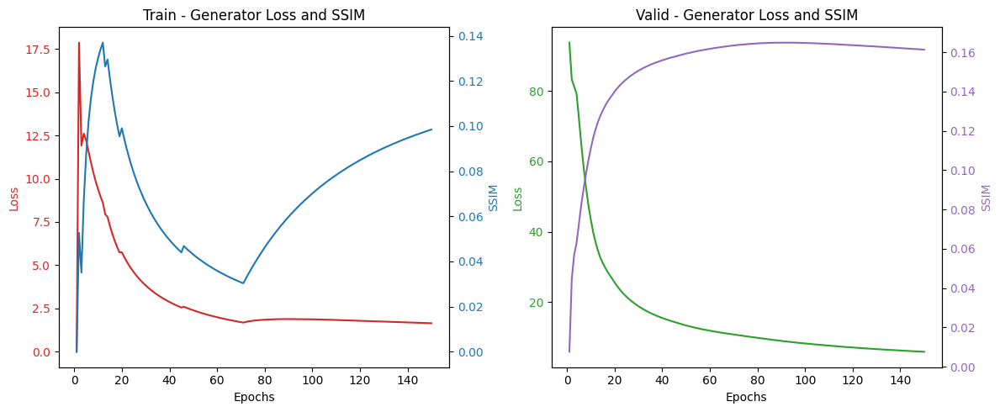

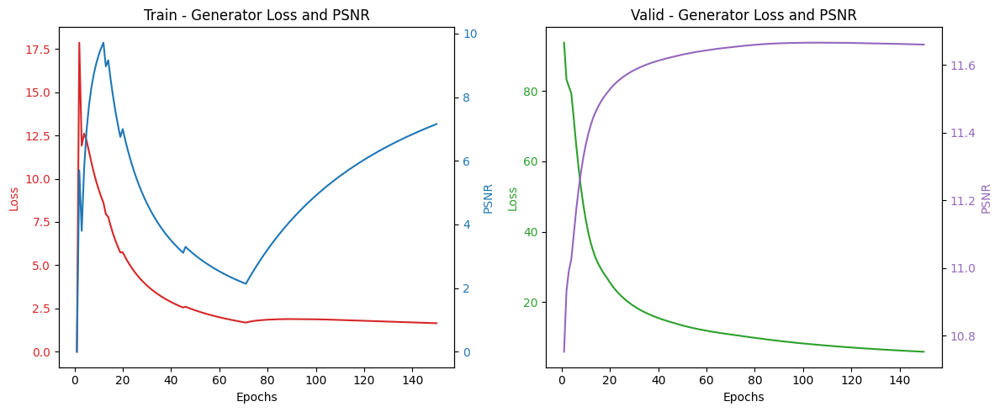

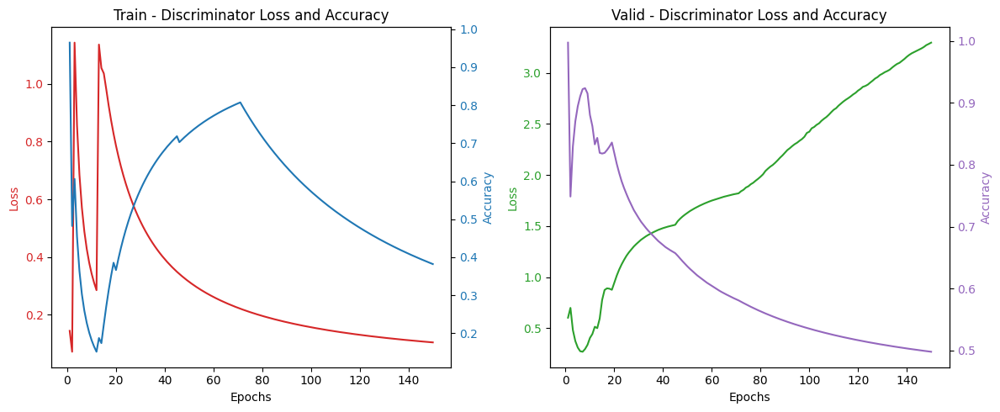

Epoch 151/10000  Train[G_Loss:0.93983 SSIM:14.93% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:0.91195 SSIM:14.93% PSNR:11.63 Disc:4.95088 42.330%] - 8s - Training: Generator 
Epoch 152/10000  Train[G_Loss:0.80921 SSIM:14.93% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:1.00688 SSIM:14.96% PSNR:11.62 Disc:4.34480 42.330%] - 8s - Training: Generator 
Epoch 153/10000  Train[G_Loss:0.98321 SSIM:14.91% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:1.21299 SSIM:15.04% PSNR:11.63 Disc:4.86357 42.330%] - 8s - Training: Generator 
Epoch 154/10000  Train[G_Loss:1.00616 SSIM:15.00% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:1.01184 SSIM:15.13% PSNR:11.63 Disc:4.39097 42.330%] - 8s - Training: Generator 
Epoch 155/10000  Train[G_Loss:0.86835 SSIM:15.01% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:1.00305 SSIM:14.91% PSNR:11.63 Disc:5.44173 42.330%] - 8s - Training: Generator 
Epoch 156/10000  Train[G_Loss:0.91753 SSIM:14.95% PSNR:11.63 Disc:0.00000 0.000%]  Valid[G_Loss:0.86764 SSIM:14.92%

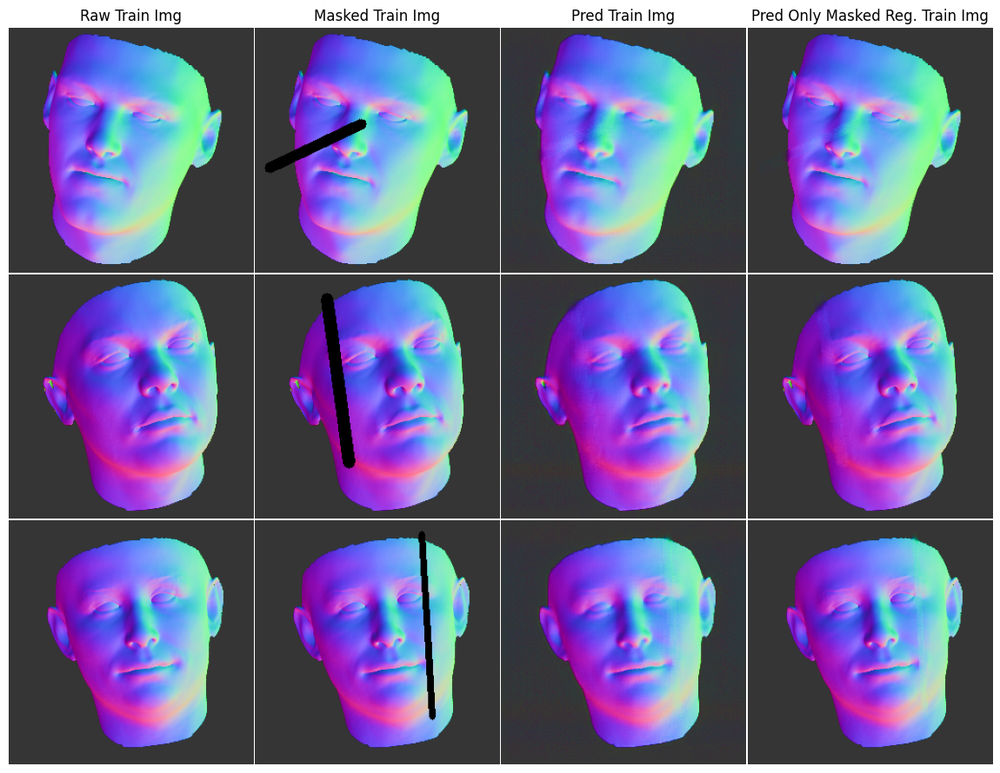

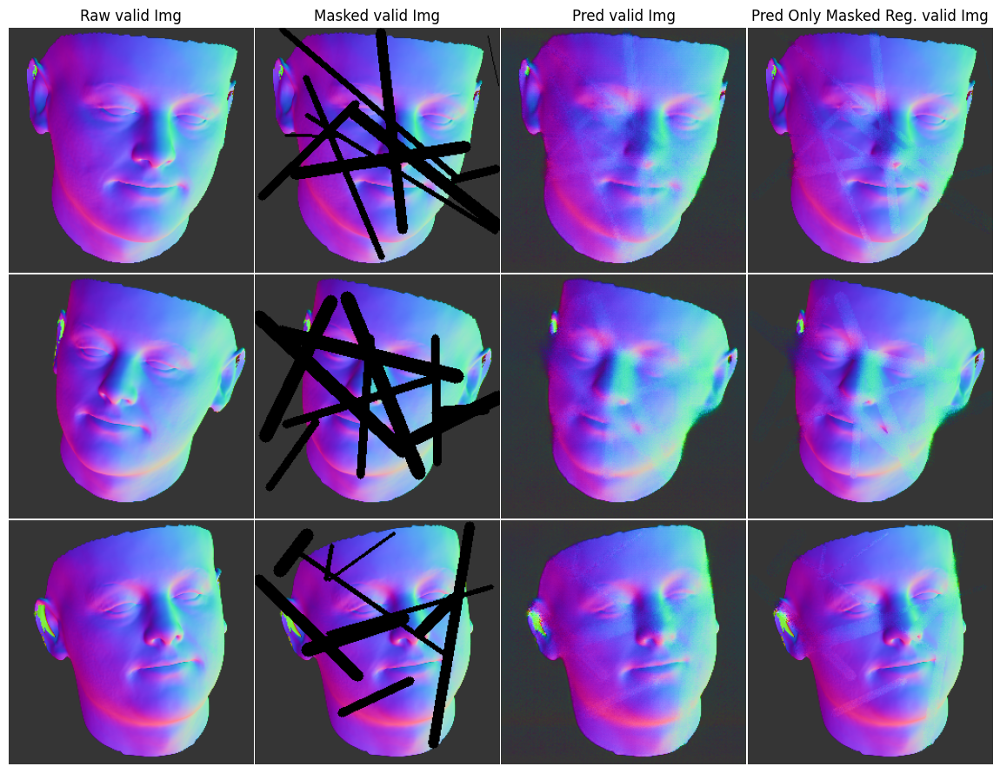

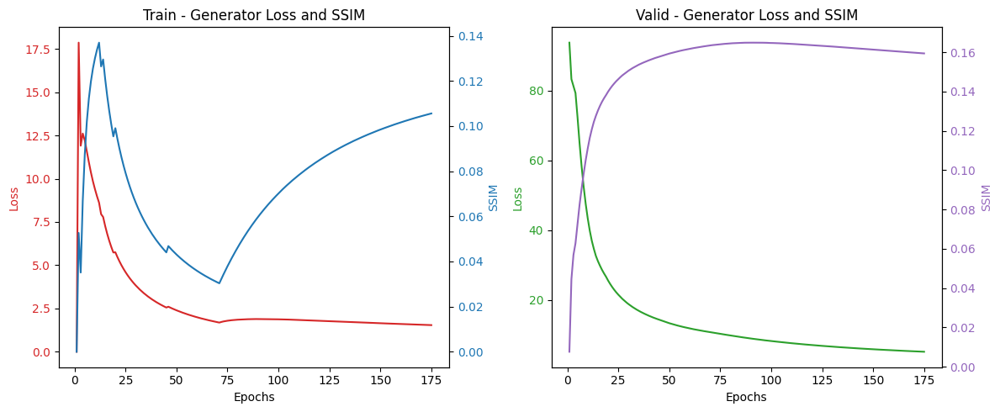

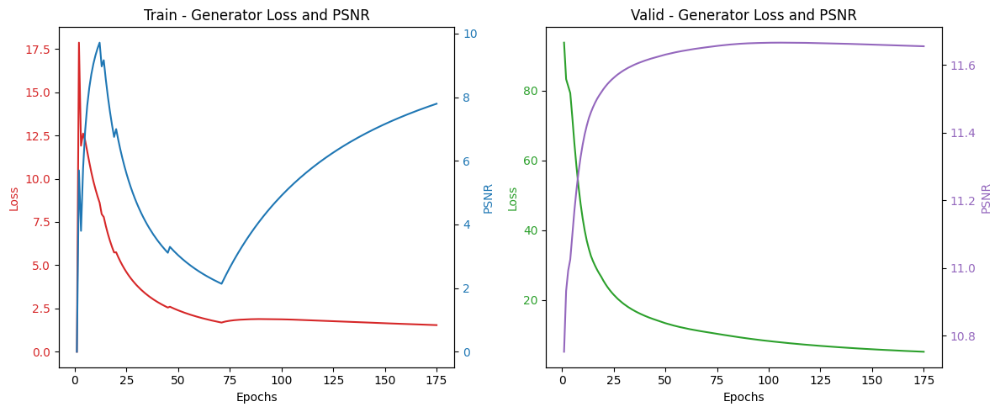

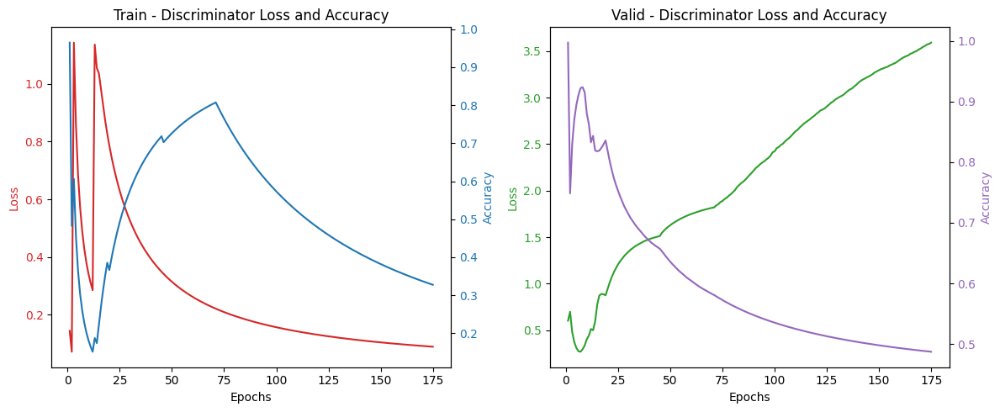

Epoch 176/10000  Train[G_Loss:0.97080 SSIM:14.84% PSNR:11.62 Disc:0.00000 0.000%]  Valid[G_Loss:0.91293 SSIM:14.71% PSNR:11.62 Disc:5.53088 42.330%] - 8s - Training: Generator 
Epoch 177/10000  Train[G_Loss:0.88828 SSIM:14.76% PSNR:11.62 Disc:0.00000 0.000%]  Valid[G_Loss:0.97266 SSIM:14.66% PSNR:11.62 Disc:5.64952 42.330%] - 8s - Training: Generator 
Epoch 178/10000  Train[G_Loss:0.80104 SSIM:14.75% PSNR:11.62 Disc:0.00000 0.000%]  Valid[G_Loss:0.86760 SSIM:14.79% PSNR:11.62 Disc:4.21519 42.330%] - 7s - Training: Generator 
Epoch 179/10000  Train[G_Loss:0.79596 SSIM:14.72% PSNR:11.62 Disc:0.00000 0.000%]  Valid[G_Loss:0.72464 SSIM:14.55% PSNR:11.62 Disc:5.79975 42.330%] - 7s - Training: Generator 
Epoch 180/10000  Train[G_Loss:0.78068 SSIM:14.65% PSNR:11.62 Disc:0.00000 0.000%]  Valid[G_Loss:0.63677 SSIM:14.44% PSNR:11.61 Disc:5.75622 42.330%] - 8s - Training: Generator Checkpoint&Models saved (epoch 180)
Epoch 181/10000  Train[G_Loss:0.76582 SSIM:14.63% PSNR:11.62 Disc:0.00000 0.000%

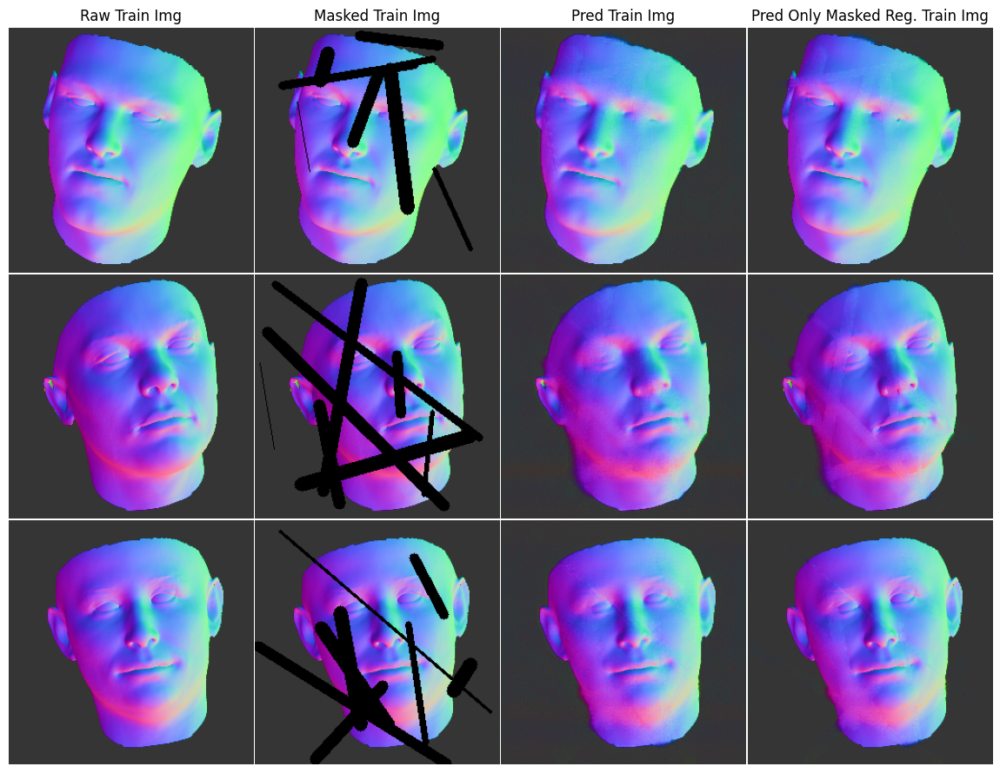

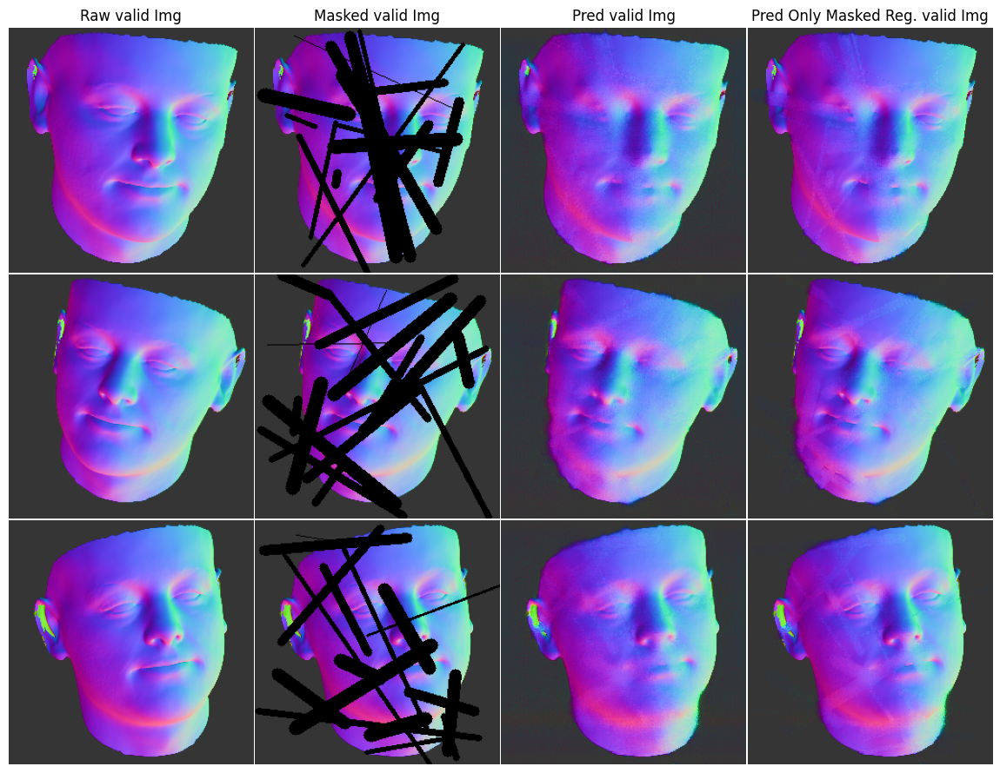

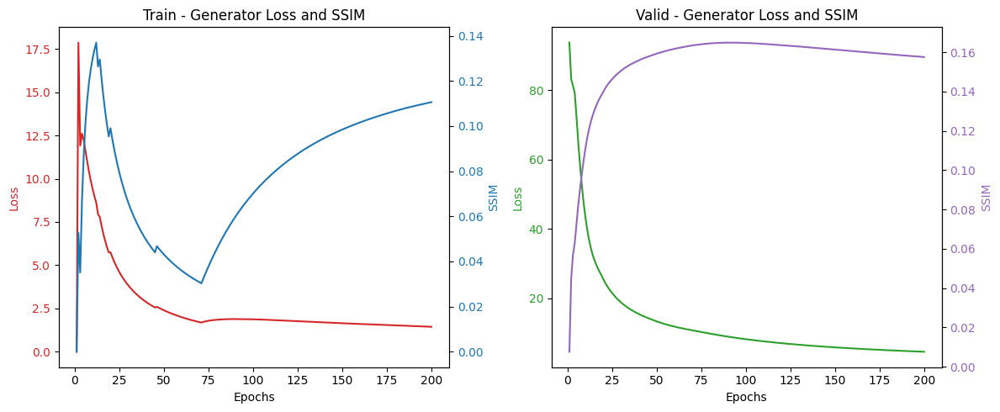

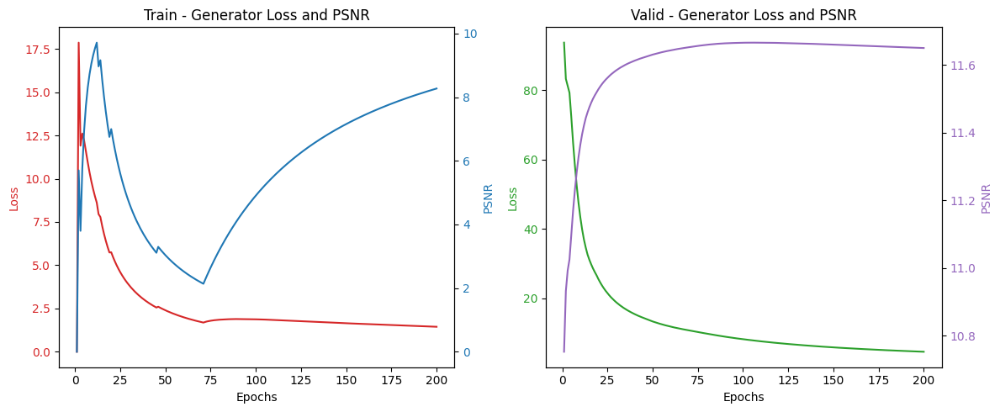

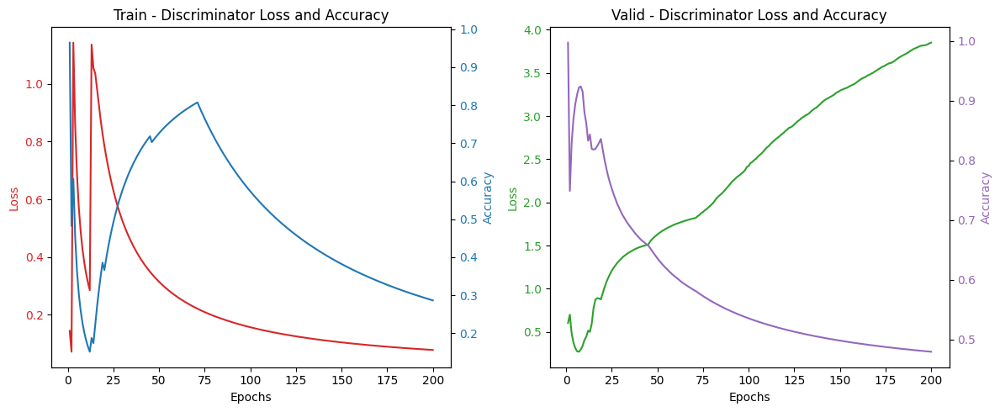

Epoch 201/10000  Train[G_Loss:0.80086 SSIM:14.54% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:0.85044 SSIM:14.64% PSNR:11.61 Disc:4.94921 42.330%] - 8s - Training: Generator 
Epoch 202/10000  Train[G_Loss:0.90487 SSIM:14.63% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:6.72412 SSIM:13.96% PSNR:11.58 Disc:8.33804 42.330%] - 8s - Training: Generator 
Epoch 203/10000  Train[G_Loss:0.85401 SSIM:14.60% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:1.44603 SSIM:14.59% PSNR:11.62 Disc:7.00889 42.330%] - 8s - Training: Generator 
Epoch 204/10000  Train[G_Loss:0.81141 SSIM:14.57% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:0.94518 SSIM:14.52% PSNR:11.61 Disc:5.12226 42.330%] - 8s - Training: Generator 
Epoch 205/10000  Train[G_Loss:0.76804 SSIM:14.48% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:0.88499 SSIM:14.40% PSNR:11.61 Disc:6.23513 42.330%] - 8s - Training: Generator 
Epoch 206/10000  Train[G_Loss:0.72512 SSIM:14.38% PSNR:11.61 Disc:0.00000 0.000%]  Valid[G_Loss:0.66112 SSIM:14.32%

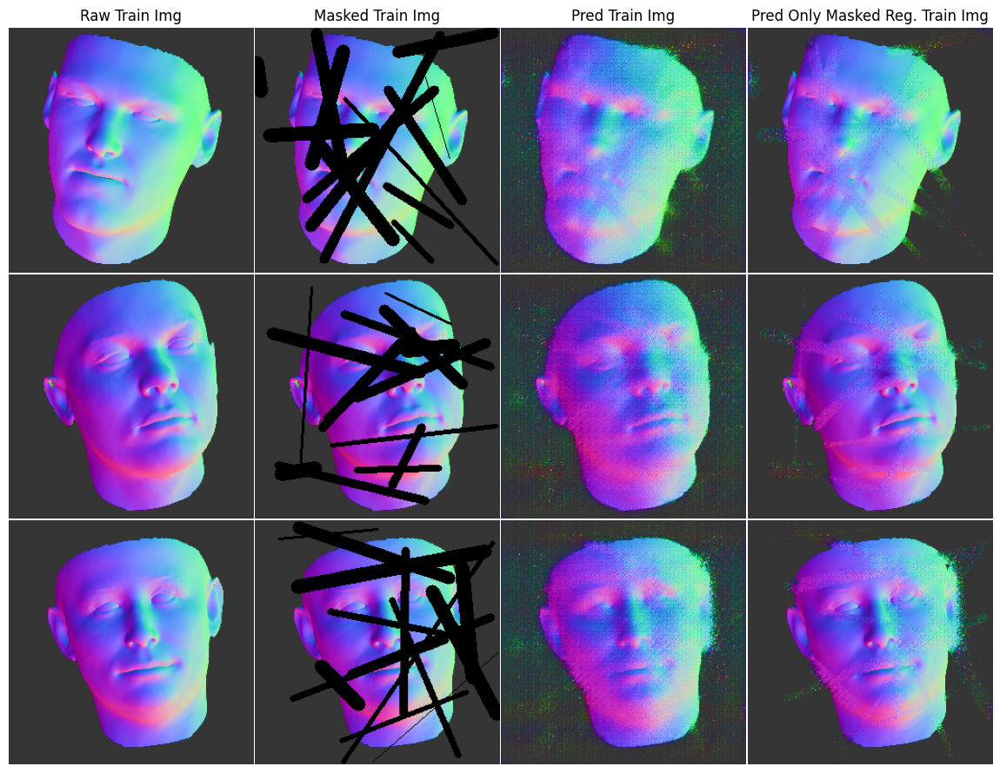

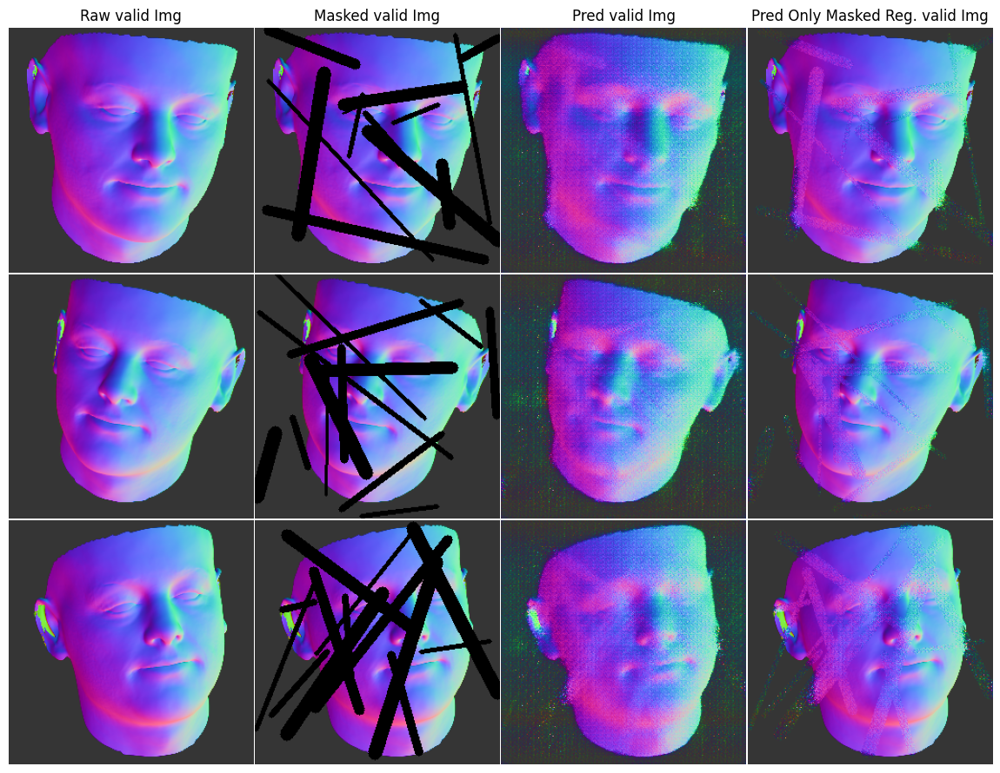

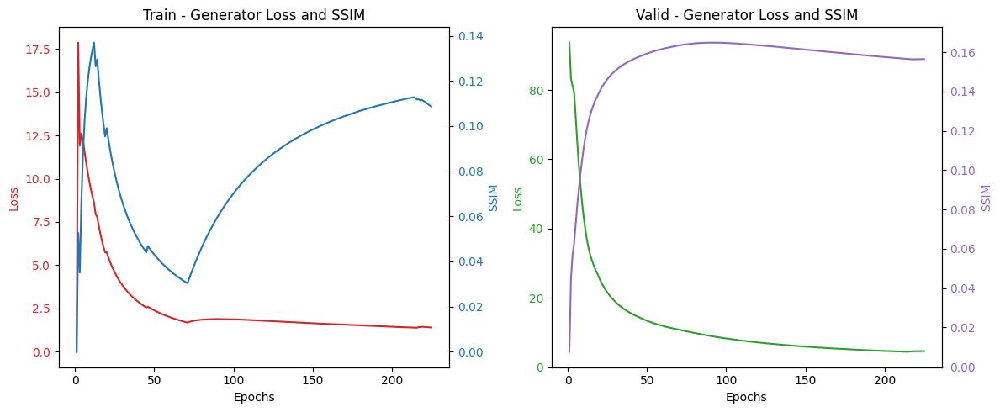

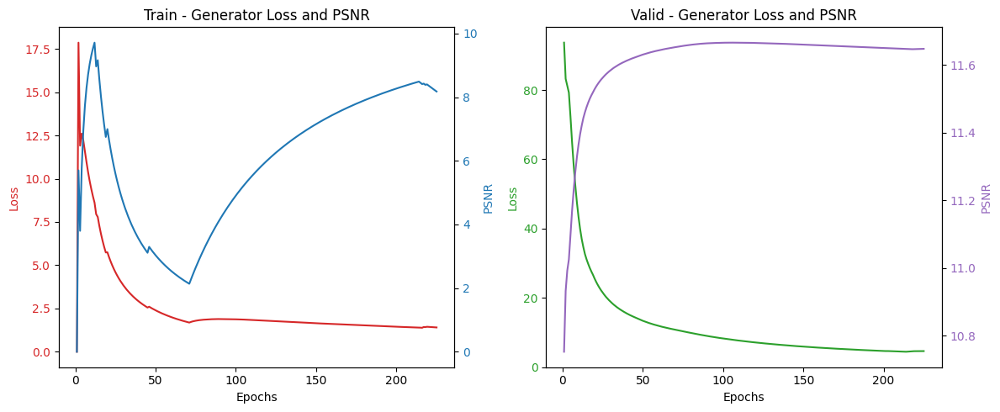

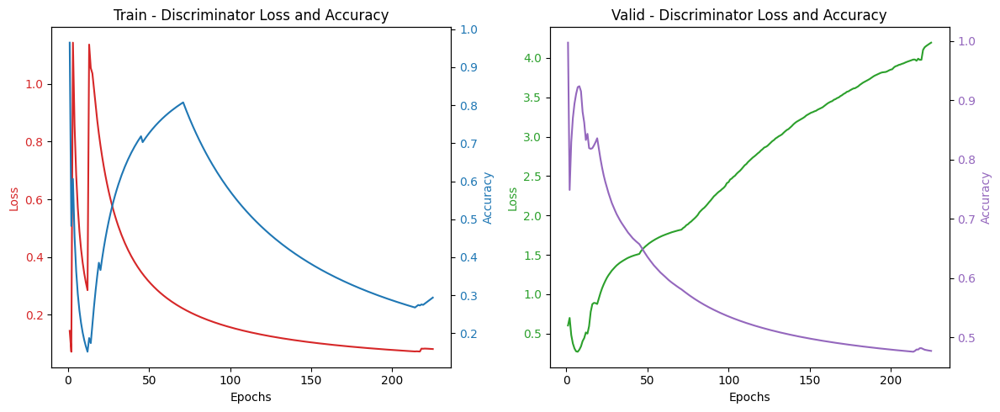

Epoch 226/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss:5.19527 SSIM:16.10% PSNR:11.68 Disc:7.14957 38.068%] - 5s - Training: Discriminator 
Epoch 227/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss:5.29378 SSIM:16.05% PSNR:11.68 Disc:7.15821 38.068%] - 5s - Training: Discriminator 
Epoch 228/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss:5.24915 SSIM:16.07% PSNR:11.68 Disc:7.14841 38.636%] - 5s - Training: Discriminator 
Epoch 229/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss:5.38644 SSIM:15.99% PSNR:11.68 Disc:7.13858 38.636%] - 5s - Training: Discriminator 
Epoch 230/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss:5.27872 SSIM:16.07% PSNR:11.68 Disc:7.11922 38.636%] - 5s - Training: Discriminator 
Epoch 231/10000  Train[G_Loss:0.00000 SSIM:0.00% PSNR:0.00 Disc:0.00002 100.000%]  Valid[G_Loss

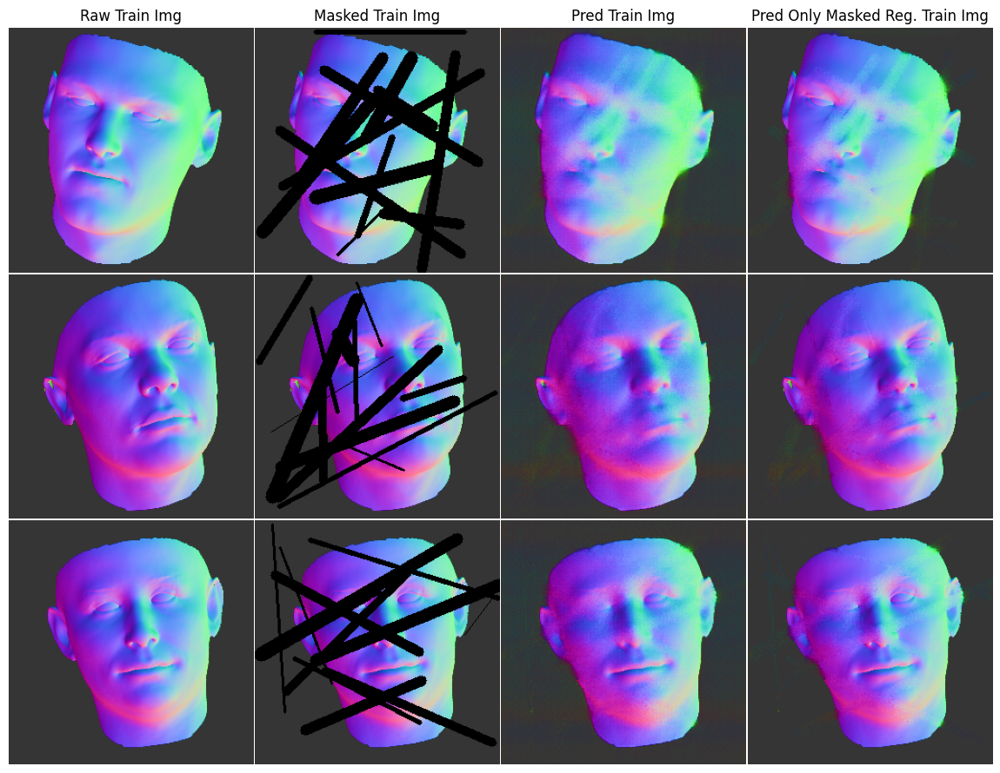

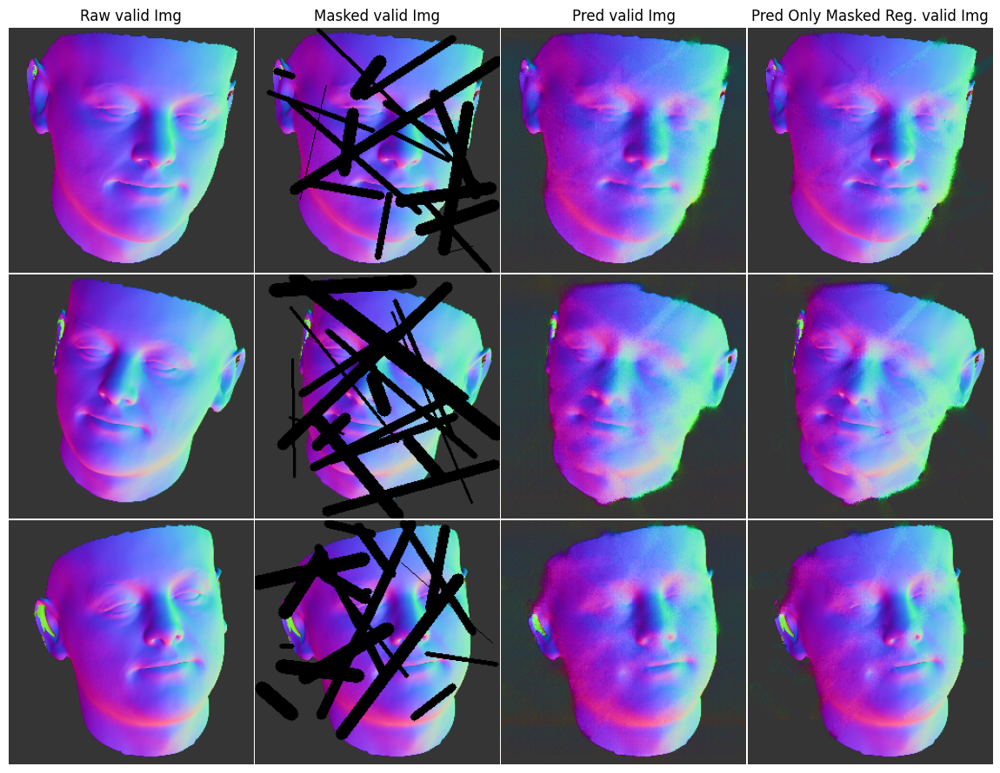

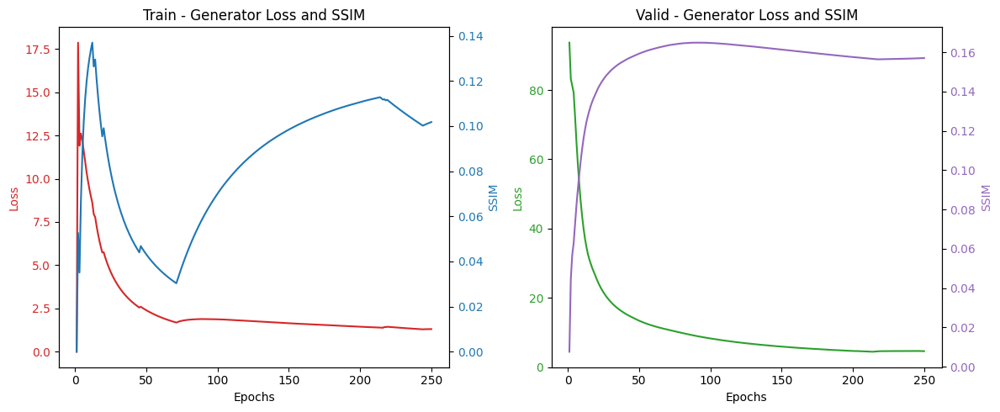

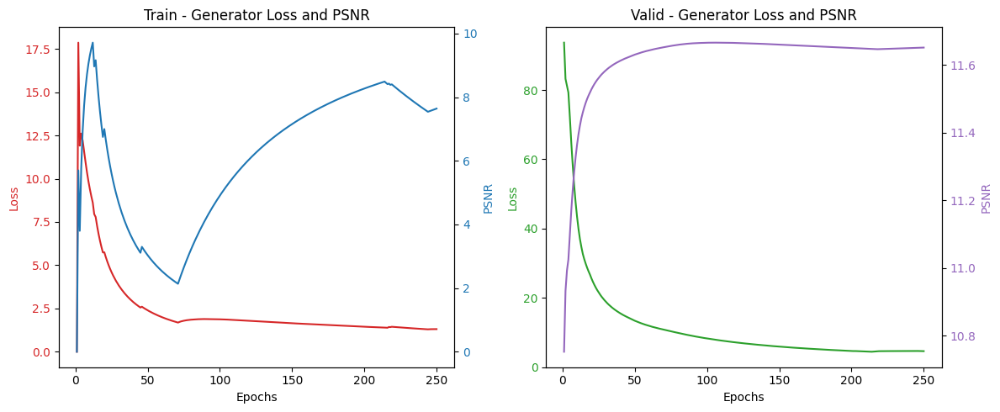

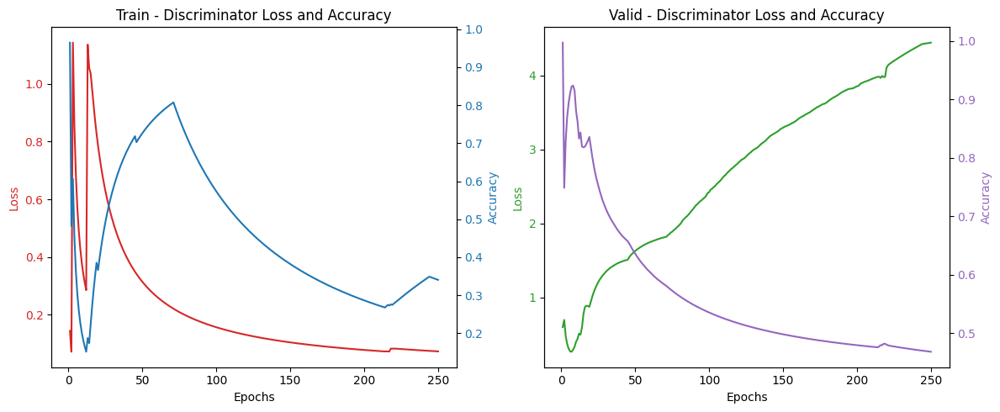

Epoch 251/10000  Train[G_Loss:1.18652 SSIM:15.86% PSNR:11.67 Disc:0.00000 0.000%]  Valid[G_Loss:1.31813 SSIM:15.71% PSNR:11.66 Disc:5.09822 38.920%] - 8s - Training: Generator 
Epoch 252/10000  Train[G_Loss:1.11079 SSIM:15.73% PSNR:11.66 Disc:0.00000 0.000%]  Valid[G_Loss:0.94313 SSIM:15.60% PSNR:11.66 Disc:5.20156 38.920%] - 8s - Training: Generator 
Epoch 253/10000  Train[G_Loss:1.10333 SSIM:15.51% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.05901 SSIM:15.40% PSNR:11.65 Disc:5.11655 38.920%] - 8s - Training: Generator 
Epoch 254/10000  Train[G_Loss:1.10768 SSIM:15.37% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.06755 SSIM:15.33% PSNR:11.65 Disc:5.14017 38.920%] - 8s - Training: Generator 
Epoch 255/10000  Train[G_Loss:1.04992 SSIM:15.33% PSNR:11.65 Disc:0.00000 0.000%]  Valid[G_Loss:1.25231 SSIM:15.21% PSNR:11.64 Disc:5.35941 38.920%] - 8s - Training: Generator 
Epoch 256/10000  Train[G_Loss:0.97665 SSIM:15.24% PSNR:11.64 Disc:0.00000 0.000%]  Valid[G_Loss:1.21417 SSIM:15.15%

In [42]:
train(train_dataset, valid_dataset, max_epochs=10000, epoch_break=25, batches_list_num=10, generator=generator, discriminator=discriminator, early_stopping_rounds = 25)

# Testing and Evaluation on Test Dataset

### Load trained generator

In [42]:
BATCH_SIZE = 16
test_dir = '../dataset/test/'
test_files = glob.glob(test_dir + '*_normal_*.png')
def preprocess(images):
    images = tf.image.resize(images, [256, 256])
    images = tf.cast(images, tf.float32)
    images = (images - 127.5) / 127.5 # [-1, 1]
    return images

def load_and_preprocess_image(file_path):
    # print("file_path", file_path)
    # Load the image from file
    image = tf.io.read_file(file_path)
    # Decode the image to a tensor
    image = tf.image.decode_jpeg(image, channels=3)
    # Preprocess the image
    image = preprocess(image)
    return image

def normalise(images):
    images,images_norm = tf.linalg.normalize(images, axis=2) #Normalise the input data
    return images

test_dataset = tf.data.Dataset.from_tensor_slices(test_files)
test_dataset = test_dataset.map(load_and_preprocess_image)
test_dataset = test_dataset.map(normalise)
print("Test dataset size:", len(test_files))
test_dataset = test_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
print("Total number of batches in test dataset:", len(list(test_dataset)))
print("Test dataset: ", tf.data.DatasetSpec.from_value(test_dataset))

Test dataset size: 162
Total number of batches in test dataset: 11
Test dataset:  DatasetSpec(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorShape([]))


In [43]:
gen_model_pth = './saved_model/generator_best.h5'
if os.path.exists(gen_model_pth):
    print('Load generator model')
    generator = tf.keras.models.load_model(gen_model_pth, custom_objects={'UnitNormalize': UnitNormalize})
    
dis_model_pth = './saved_model/discriminator_best.h5'
if os.path.exists(dis_model_pth):
    print('Load discriminator model')
    discriminator = tf.keras.models.load_model(dis_model_pth, compile=False)

Load generator model
Load discriminator model


In [44]:
def mask_irregular(batch_size, mask_width, mask_height, seed=27):
    random.seed(seed)
    np.random.seed(seed)
    
    size = int(round((mask_width + mask_height) * 0.03))
    mask = np.zeros((batch_size, mask_width, mask_height, 1))
    
    num_lines = np.random.randint(1, 20)
    x1, x2 = np.random.randint(1, mask_width, num_lines), np.random.randint(1, mask_width, num_lines)
    y1, y2 = np.random.randint(1, mask_height, num_lines), np.random.randint(1, mask_height, num_lines)
    thickness = np.random.randint(1, size, num_lines)
    
    for i in range(batch_size):
        for j in range(num_lines):
            cv2.line(mask[i], (x1[j], y1[j]), (x2[j], y2[j]), (1,), thickness[j])

    return np.float32(((1 - mask) * 2) - 1) # [-1, 1]

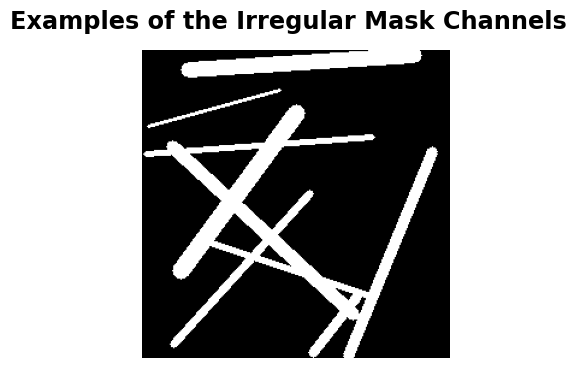

In [45]:
irregular_mask_examples = mask_irregular(6, 256, 256)
for ax, img in zip(ImageGrid(plt.figure(figsize=(6, 4)), 111, nrows_ncols=(1, 1), axes_pad=0.3), 
                   irregular_mask_examples):
    ax.imshow((img+1)/2, cmap='binary')
    ax.axis('off')
plt.suptitle('Examples of the Irregular Mask Channels', fontsize='xx-large',fontweight='heavy')
plt.show()

In [46]:
def generator_cosine_similarity_loss(real_images, generated_images):
    # Cosine similarity is maximized, so we negate the value to minimize loss
    return cosine_loss(real_images, generated_images)

In [47]:
# Evaluating data from a single batch
@tf.function
def evaluate_batch(raw_images, mask_channels):
    masked_images = masked_imgs(raw_images, mask_channels)
    generated_images = generator([masked_images, mask_channels], training=False)
    real_output = discriminator(raw_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    return {
        'gen_loss': generator_cosine_similarity_loss(raw_images, generated_images),
        'gen_ssim': generator_ssim(raw_images, generated_images),
        'gen_psnr': generator_psnr(raw_images, generated_images),
        'disc_loss': discriminator_loss(real_output, fake_output),
        'disc_acc': discirminator_acc(real_output, fake_output)
    }

# Overall assessment function
def assessment(dataset):
    metrics_sums = {
        'gen_loss': 0,
        'gen_ssim': 0,
        'gen_psnr': 0,
        'disc_loss': 0,
        'disc_acc': 0
    }
    batch_count = 0
    
    for images_batch in dataset:
        batch_metrics = evaluate_batch(images_batch, mask_irregular(images_batch.shape[0], images_batch.shape[1], images_batch.shape[2]))
        batch_count += 1

        for key in metrics_sums:
            metrics_sums[key] += batch_metrics[key].numpy()

    return {key: total / batch_count for key, total in metrics_sums.items()}

In [48]:
test_metrics = assessment(test_dataset)

print("Test dataset Avg LOSS: {:.4f}\n"
      "Test dataset Avg SSIM: {:.4f}\n"
      "Test dataset Avg PSNR: {:.4f}\n"
      "Test dataset Disc Avg Loss: {:.4f}\n"
      "Test dataset Disc Avg ACC: {:.2f}%".format(test_metrics['gen_loss'], 
                                                  test_metrics['gen_ssim'], 
                                                  test_metrics['gen_psnr'], 
                                                  test_metrics['disc_loss'], 
                                                  test_metrics['disc_acc'] * 100))

Test dataset Avg LOSS: -0.9903
Test dataset Avg SSIM: 0.1435
Test dataset Avg PSNR: 11.6100
Test dataset Disc Avg Loss: 5.9992
Test dataset Disc Avg ACC: 40.34%


In [49]:
print('Pred time for a batch')
for images_batch in test_dataset.take(1):
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

Pred time for a batch
1/1 [==============================] - 0s 253ms/step


In [50]:
def generator_plot_images(gen_model, text, dataset, num=3, batch_num=0, start_img=0, end_img=None, save_path='./saved_images', epoch=0, save_images=False, dpi=300):
    os.makedirs(save_path, exist_ok=True)

    # 选择指定的batch
    for batch_idx, images_batch in enumerate(dataset):
        if batch_idx == batch_num:
            raw_images = images_batch
            # 如果没有指定end_img，则显示从start_img开始的num张图像
            end_img = end_img or start_img + num
            # 确保索引不超出范围
            end_img = min(end_img, raw_images.shape[0])
            mask_channels = mask_irregular(raw_images.shape[0], raw_images.shape[1], raw_images.shape[2])
            masked_images = masked_imgs(raw_images, mask_channels)
            pred_images = gen_model([masked_images, mask_channels], training=False)
            pred_images, pred_norm = tf.linalg.normalize(pred_images, axis=3)

            masked_region_pred_images = only_masked_region_pred_imgs(mask_channels, masked_images, pred_images)

            # 调整图像网格大小以适应选定的图像数量
            grid = ImageGrid(plt.figure(figsize=(12, (end_img - start_img) * 3), dpi=dpi), 111, nrows_ncols=((end_img - start_img), 4))

            # 仅处理指定范围内的图像
            for i in range(start_img, end_img):
                ax_idx = i - start_img

                ax = grid[ax_idx * 4]
                ax.imshow((raw_images[i] + 1) / 2)
                ax.axis('off')
                if ax_idx == 0:
                    ax.set_title('Raw {} Img'.format(text), fontsize =15)

                ax = grid[ax_idx * 4 + 1]
                ax.imshow((masked_images[i] + 1) / 2)
                ax.axis('off')
                if ax_idx == 0:
                    ax.set_title('Masked {} Img'.format(text), fontsize =15)

                ax = grid[ax_idx * 4 + 2]
                ax.imshow((pred_images[i] + 1) / 2)
                ax.axis('off')
                if ax_idx == 0:
                    ax.set_title('Pred {} Img'.format(text), fontsize =15)

                ax = grid[ax_idx * 4 + 3]
                ax.imshow((masked_region_pred_images[i] + 1) / 2)
                ax.axis('off')
                if ax_idx == 0:
                    ax.set_title('Pred Only Masked Reg.'.format(text),  fontsize =15)

            plt.tight_layout()
            if save_images:
                image_save_path = os.path.join(save_path, f'{text}_epoch_{epoch}.png')
                plt.savefig(image_save_path, dpi=dpi)
            plt.show()

            # 一旦找到并处理了指定的batch，就跳出循环
            break


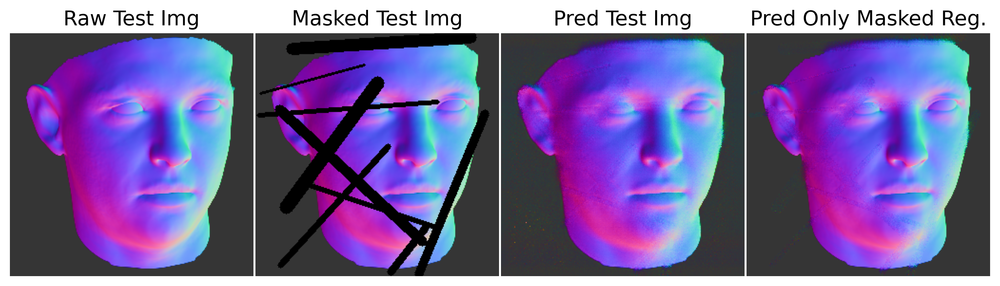

In [51]:
generator_plot_images(generator, 'Test', test_dataset, batch_num=9, start_img=0, end_img=1, epoch='final', save_images=True)

### Reading and plotting data from log data file

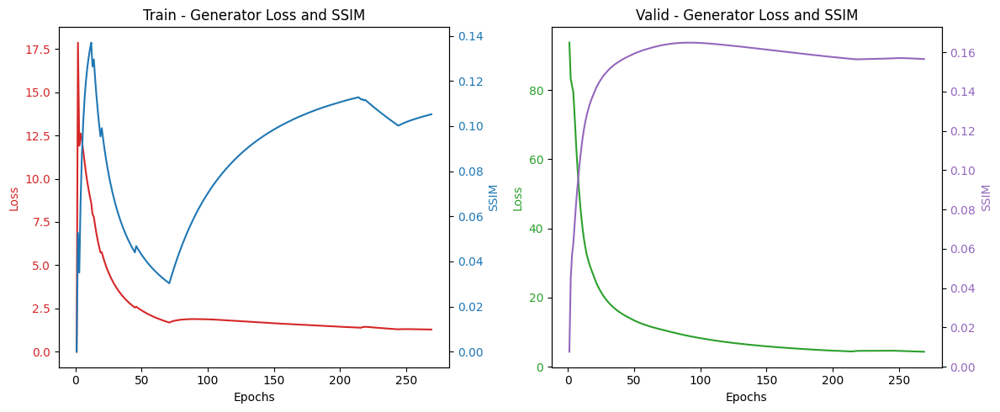

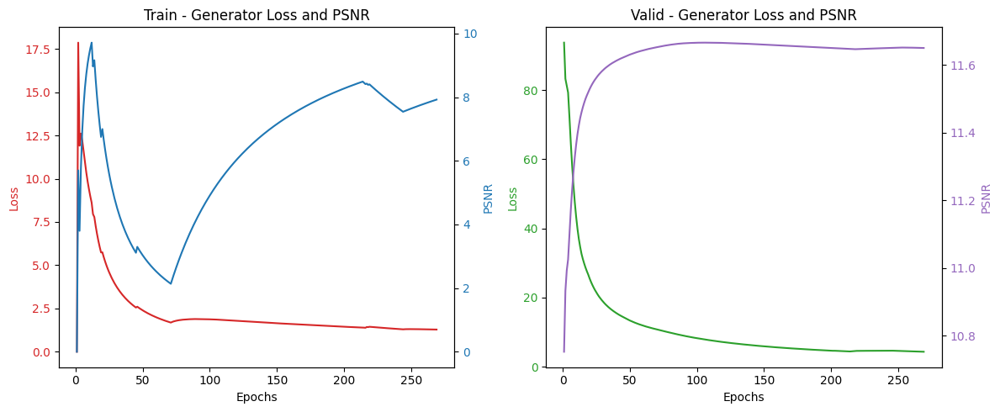

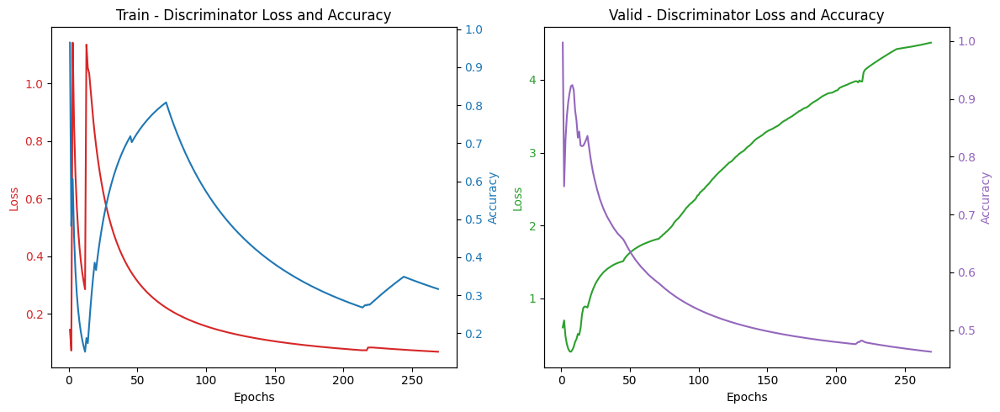

In [52]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
plot_metrics(load_metrics_from_csv(log_file))

In [53]:
def plot_loss_metric(train_loss, train_metric, test_loss, test_metric, title, metric, start=0):
    x_values = range(start, start + len(train_loss))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plotting the training set
    ax_train_loss = ax1
    ax_train_metric = ax1.twinx()
    ax_train_loss.plot(x_values, train_loss, color='tab:red')
    ax_train_metric.plot(x_values, train_metric, color='tab:blue')

    ax_train_loss.set_xlabel('Epochs')
    ax_train_loss.set_ylabel('Loss', color='tab:red')
    ax_train_metric.set_ylabel(metric, color='tab:blue')

    ax_train_loss.tick_params(axis='y', labelcolor='tab:red')
    ax_train_metric.tick_params(axis='y', labelcolor='tab:blue')

    ax1.set_title('Train - ' + title)

    # Plotting the test set
    ax_test_loss = ax2
    ax_test_metric = ax2.twinx()
    ax_test_loss.plot(x_values, test_loss, color='tab:green')
    ax_test_metric.plot(x_values, test_metric, color='tab:purple')

    ax_test_loss.set_xlabel('Epochs')
    ax_test_loss.set_ylabel('Loss', color='tab:green')
    ax_test_metric.set_ylabel(metric, color='tab:purple')

    ax_test_loss.tick_params(axis='y', labelcolor='tab:green')
    ax_test_metric.tick_params(axis='y', labelcolor='tab:purple')

    ax2.set_title('U-Net (Valid - ' + title +')', fontsize=14)

    plt.tight_layout()
    plt.savefig("./saved_images/filename.png", dpi=300)
    plt.show()

In [54]:
def plot_metrics(metrics_lists):
    start_epoch = 1
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
                     metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_ssim'], 
                     'Generator Loss and SSIM', 'SSIM', start=start_epoch)
    plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                     metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_psnr'], 
                     'Generator Loss and PSNR', 'PSNR', start=start_epoch)
    plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
                     metrics_lists['valid_disc_loss'], metrics_lists['valid_disc_acc'], 
                     'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

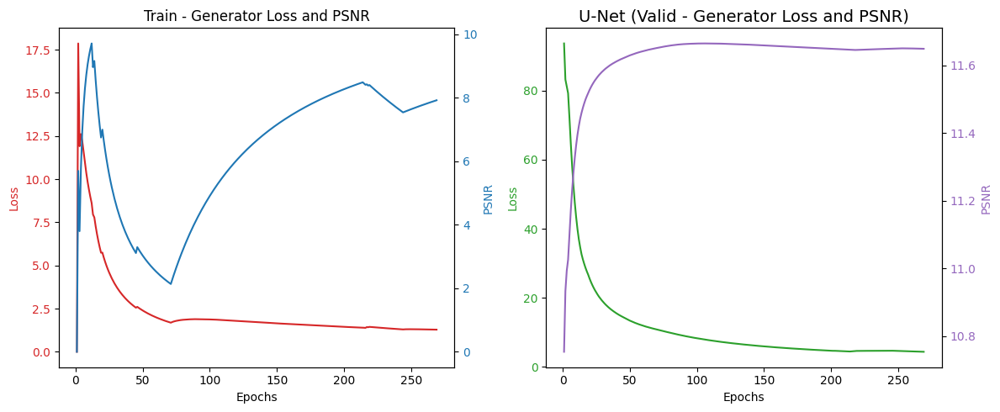

In [55]:
log_dir = './saved_logs'
os.makedirs(log_dir, exist_ok=True)
log_file = os.path.join(log_dir, "GAN_training_results.csv")
metrics_lists = load_metrics_from_csv(log_file)
start_epoch = 1
# plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_ssim'], 
#                  metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_ssim'], 
#                  'Generator Loss and SSIM', 'SSIM', start=start_epoch)
plot_loss_metric(metrics_lists['train_gen_loss'], metrics_lists['train_gen_psnr'], 
                 metrics_lists['valid_gen_loss'], metrics_lists['valid_gen_psnr'], 
                 'Generator Loss and PSNR', 'PSNR', start=start_epoch)
# plot_loss_metric(metrics_lists['train_disc_loss'], metrics_lists['train_disc_acc'], 
#                  metrics_lists['valid_disc_loss'], metrics_lists['valid_disc_acc'], 
#                  'Discriminator Loss and Accuracy', 'Accuracy', start=start_epoch)

In [56]:
def load_metrics_from_csv_with_time(log_file):
    metrics_lists = {'elapsed_time': []
    }
    total_elapsed_time = 0

    if os.path.exists(log_file) and os.path.getsize(log_file) > 0:
        with open(log_file, "r") as file:
            reader = csv.DictReader(file)
            for row in reader:
                for key in metrics_lists.keys():
                    if key == 'elapsed_time':
                        elapsed_time = float(row['Elapsed Time (Seconds)'])
                        metrics_lists[key].append(elapsed_time)
                        total_elapsed_time += elapsed_time
                    else:
                        metrics_lists[key].append(float(row[key]))

    return metrics_lists, total_elapsed_time

metrics, total_time = load_metrics_from_csv_with_time(log_file)
print("Total Training Time: ", total_time, "seconds")


import time

print('Pred time for the entire test dataset')

start_time = time.time()

for images_batch in test_dataset:
    test_raw_images = images_batch
    test_mask_channels = mask_irregular(test_raw_images.shape[0], test_raw_images.shape[1], test_raw_images.shape[2])
    test_masked_images = masked_imgs(test_raw_images, test_mask_channels)
    test_pred_images = generator.predict([test_masked_images, test_mask_channels], batch_size=BATCH_SIZE)

end_time = time.time()

total_time = end_time - start_time
print(f'Total prediction time for the entire test dataset: {total_time:.2f} seconds')

Total Training Time:  1857.3379282951355 seconds
Pred time for the entire test dataset
1/1 [==============================] - 0s 226ms/step
Total prediction time for the entire test dataset: 3.82 seconds
